# Practical Machine Learning for Physicists
## Week 6 Exercise
## Deadline Monday 30th November at 12pm (Noon)

In this notebook you will be trying to predict a system using incomplete information. We will set up the equations of motions for a simple double pendulum (or should that be a double simple pendulum. Then we will see if a machine learning technique can predict the future position of the lower mass, using only the lower mass positions.

### Kinematics of the double pendulum
Let's specify our problem in terms of the following, with the origin at the pivot point of the top pendulum. This is just background for the machine learning tasks at the bottom of the notebook.

#### Positions
$$x_1 = L_1 \sin \theta_1$$
$$y_1 = -L_1 \cos \theta_1$$
$$x_2 = x_1 + L_2 \sin \theta_2$$
$$y_2 = y_1 - L_2 \cos \theta_2$$

#### Velocities
$$\dot{x}_1 = \dot{\theta_1} L_1 \cos \theta_1$$
$$\dot{y_1} =  \dot{\theta_1} L_1 \sin \theta_1$$
$$\dot{x_2} = \dot{x_1} + \dot{\theta_2} L_2 \cos \theta_2$$
$$\dot{y_2} = \dot{y_1} + \dot{\theta_2} L_2 \sin \theta_2$$


#### Accelerations

$$\ddot{x}_1 = -\dot{\theta_1}^2 L_1 \sin \theta_1 + \ddot{\theta_1} L_1 \cos \theta_1$$
$$\ddot{y_1} =  \dot{\theta_1}^2 L_1 \cos \theta_1 + \ddot{\theta_1} L_1 \sin \theta_1$$
$$\ddot{x_2} = \ddot{x_1} - \dot{\theta_2}^2 L_2 \sin \theta_2 + \ddot{\theta_2} L_2 \cos \theta_2$$
$$\ddot{y_2} = \ddot{y_1} + \dot{\theta_2}^2 L_2 \cos \theta_2 + \ddot{\theta_2} L_2 \sin \theta_2$$

#### Energies
Let $v_1^2 = \dot{x_1}^2 +\dot{y_1}^2$ and $v_2^2 = \dot{x_2}^2 +\dot{y_2}^2$ then the kinetic energies $T_1$ and $T_2$ are
$$ T_1 = \frac{1}{2}m_1 v_1^2 = \frac{1}{2}m_1 L_1^2 \dot{\theta_1}^2 $$
$$ T_2 = \frac{1}{2}m_2 v_2^2 = \frac{1}{2}m_2 \left( L_1^2 \dot{\theta_1}^2 + L_2^2 \dot{\theta_2}^2 + 2L_1 L_2 \cos(\theta_1-\theta_2) \dot{\theta_1} \dot{\theta_2} \right) $$

The potential enrgies are
$$V_1 = m_1 g y_1 = - m_1 g L_1 \cos \theta_1$$
$$V_2 = m_2 g y_2 = -m_2 g ( L_1 \cos \theta_1 + L_2 \cos \theta_2)$$

#### Langrangian
Now we form the Lagrangian $L=T-V=T_1+T_2 -V_1 -V_2$ and use the Euler-Lagrange equations:
$$\frac{\partial L}{\partial \theta_1} = \frac{d}{dt}\frac{\partial L}{\partial \dot{\theta_1}}$$
$$\frac{\partial L}{\partial \theta_2} = \frac{d}{dt}\frac{\partial L}{\partial \dot{\theta_2}}$$

Applying these gives
$$-(m_1+m_2) g L_1 \sin \theta_1 = (m_1+m_2) L_1^2 \ddot{\theta_1} + m_2 L_1 L_2 \sin(\theta_1-\theta_2) \dot{\theta_2}^2 +  m_2 L_1 L_2 \cos(\theta_1-\theta_2) \ddot{\theta_2} $$
and
$$ -m_2 g L_2 \sin \theta_2 = m_2 L_2 \ddot{\theta_2} + m_2 L_1 L_2 \cos(\theta_1-\theta_2) \ddot{\theta_1} + m_2 L_1 L_2 \sin(\theta_1-\theta_2) \dot{\theta_1}^2 $$


#### Equations of motions
$$ \omega_1 = \dot{\theta_1}$$  

$$ \omega_2 = \dot{\theta_2}$$
$$ \ddot\theta_1 = \frac{1}{L_1\xi}\left[L_1m_2\cos(\theta_1-\theta_2)\sin(\theta_1-\theta_2)\omega_1^2 + L_2m_2\sin(\theta_1-\theta_2)\omega_2^2 - m_2g\cos(\theta_1-\theta_2)\sin(\theta_2) + (m_1+m_2)g\sin(\theta_1) \right] $$
$$ \ddot\theta_2 = \frac{1}{L_2\xi}\left[L_2m_2\cos(\theta_1-\theta_2)\sin(\theta_1-\theta_2)\omega_2^2 + L_1(m_1+m_2)\sin(\theta_1-\theta_2)\omega_1^2+(m_1+m_2)g\sin(\theta_1)\cos(\theta_1-\theta_2) - (m_1+m_2)g\sin(\theta_2) \right] $$
where
$$\xi \equiv \cos^2(\theta_1-\theta_2)m_2-m_1-m_2$$


In [28]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import solve_ivp

import tensorflow as tf
from tensorflow import keras

import matplotlib.style #Some style nonsense
import matplotlib as mpl #Some more style nonsense

#Import tqdm for progress bar
from tqdm import tqdm



#Set default figure size
#mpl.rcParams['figure.figsize'] = [12.0, 8.0] #Inches... of course it is inches
mpl.rcParams["legend.frameon"] = False
mpl.rcParams['figure.dpi']=200 # dots per inch



In [29]:
def rhs(t, z, L1, L2, m1, m2, g):
    """
    Returns the right-hand side of the ordinary differential equation describing the double pendulem
    """
    theta1, w1, theta2, w2 = z    #The four components
    cos12 = np.cos(theta1 - theta2)
    sin12 = np.sin(theta1 - theta2)
    sin1 = np.sin(theta1)
    sin2 = np.sin(theta2)
    xi = cos12**2*m2 - m1 - m2
    w1dot = ( L1*m2*cos12*sin12*w1**2 + L2*m2*sin12*w2**2
            - m2*g*cos12*sin2      + (m1 + m2)*g*sin1)/(L1*xi)
    w2dot = -( L2*m2*cos12*sin12*w2**2 + L1*(m1 + m2)*sin12*w1**2
            + (m1 + m2)*g*sin1*cos12  - (m1 + m2)*g*sin2 )/(L2*xi)
    return w1, w1dot, w2, w2dot   #Return the w's and the wdot's


def to_cartesian(theta1, w1, theta2, w2, L1, L2):
    """ Transforms theta and omega to cartesian coordinates
    and velocities x1, y1, x2, y2, vx1, vy1, vx2, vy2
    """
    x1 = L1 * np.sin(theta1)
    y1 = -L1 * np.cos(theta1)
    x2 = x1 + L2 * np.sin(theta2)
    y2 = y1 - L2 * np.cos(theta2)
    vx1 = L1*np.cos(theta1)*w1
    vy1 = L1*np.sin(theta1)*w1
    vx2 = vx1 + L2*np.cos(theta2)*w2
    vy2 = vy1 + L2*np.sin(theta2)*w2
    return x1, y1, x2, y2, vx1, vy1, vx2, vy2


In [30]:
# Set up the initial conditions. Here we have lengths and masses
L1, L2 = 1., 1.
m1, m2 = 3., 1.
g = 9.81     # [m/s^2]. Gravitational acceleration

#Starting angles
z0=[np.pi/4,0,np.pi/4,0]
#z0=[0.1,0,0.1,0]

#Time ranges
tmax, dt = 50, 0.1
t = np.arange(0, tmax+dt, dt)

In [31]:
# Solve initial value problem
ret = solve_ivp(rhs, (0,tmax), z0, t_eval=t, args=(L1, L2, m1, m2, g))
z=ret.y
print(np.shape(z))

# Extract result
theta1, w1, theta2, w2 = z[0], z[1], z[2], z[3]
x1, y1, x2, y2, vx1, vy1, vx2, vy2 = to_cartesian(theta1, w1, theta2, w2, L1, L2)

(4, 501)


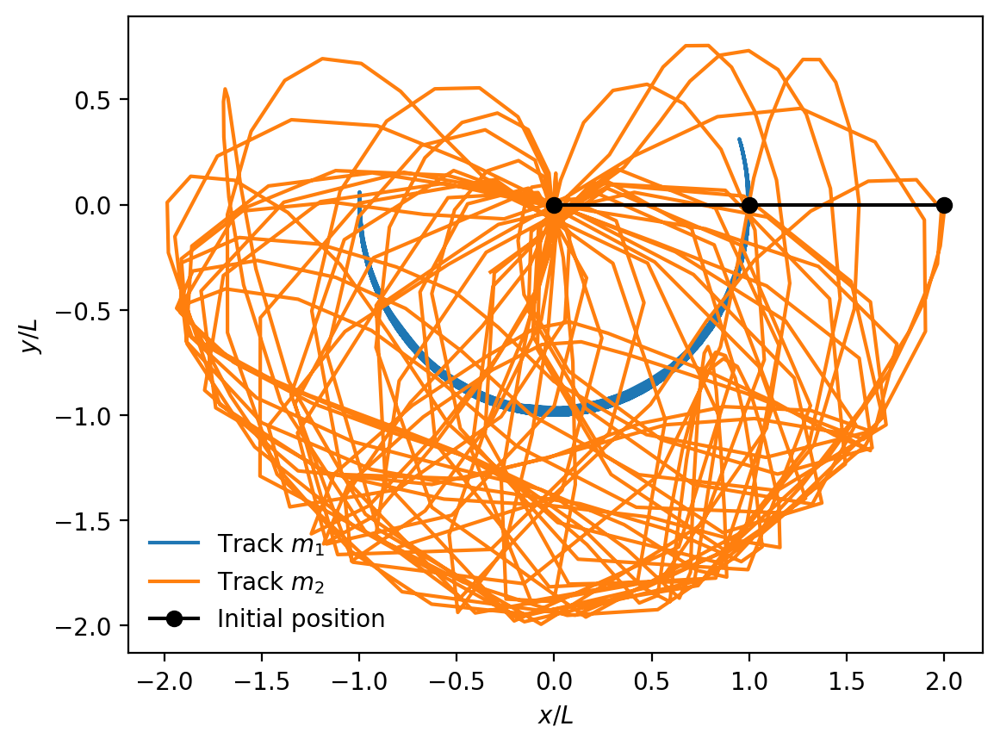

In [242]:
fig,ax=plt.subplots()
ax.plot(x1, y1, label=r"Track $m_1$")
ax.plot(x2, y2, label=r"Track $m_2$")
ax.plot([0, x1[0], x2[0]], [0, y1[0], y2[0]], "-o", label="Initial position", c='k')
plt.xlabel(r"$x/L$")
plt.ylabel(r"$y/L$")
ax.legend()

# Exercises: Predicting Chaos
1. Design and train a recurrent neural network (of your choice) to predict the future positions, where future is defined as $t=t_0 + 20 \delta t$, of the masses $m_1$ and $m_2$ using their cartesian coordinates and the initial conditions  $z_0=[\pi/4,0,\pi/4,0]$.
2. How stable is your network to variations in initial conditions? Make a plot of $x$ and $y$ vs time to show the network prediction in comparison to the solution from solve_ivp
3. How far into the future can a network predict? Make a plot showing how the deviation between predicted position and actual position (from solve_ivp above) vary as a function of extrapolation time from $t=t_0 + 20 \delta t$ to $t=t_0 + 100 \delta t$  (e.g. for each extrapolation time, train a new version of the network and then plot the performance)
4. Repeat steps 1-3 for the initial conditions $z_0=[\pi/2,0,\pi/2,0]$ which give a much more complex path.
5. Repeat steps 1-4 but only train your neural network on the cartesian coordinates of the mass $m_2$ (i.e without showing your neural network the positions of the mass $m_1$)



## Step 1.
First let's create a function which transforms our arrays to a suitable form in which we can feed it into the LSTM model

So we have all of the values for the motion of the pendulum already set up, all we need to do, we can follow the methods from the week 6 predictions notebook and adapt our work accordingly to fit our needs.

We need to define a few dimensions.
How many steps do we want to include in the training data (window size) and how far into the future do we want to predict (offset)?


In [71]:
def shapeArray(x,windowsize,offset):


  """

  This function seperates the 1-D array into a series of overlapping windows.

  Inputs: (x, windsize, offset)
  x:          - The 1-D array we are splitting
  Windowsize: - Number of samples used to train the network
  Offset:     - Number of samples we want to predict in the future

  Output:     - A tuple of the array of input windows & target (label) windows

  """
  xInput= np.array([x[i : i + windowsize] for i in range(len(x)-(windowsize+offset)+1)])
  xLabel= np.array([x[i +windowsize : i+ windowsize+offset] for i in range(len(x)-(windowsize+offset)+1)])
  return (xInput,xLabel[:,-1])

### Step 2

We need to now define a model which is trained using the positions for mass 1 and mass 2

We also need to dedine a model which is trained only using the positions of mass 2 but it will not see the positions of mass 1

https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.train_test_split.html

In [142]:
from sklearn.model_selection import train_test_split

def train_model_12(x1, y1, x2, y2, windowsize, offset):

  """

  Trains the model using the positions of both mass 1 and mass 2 of the double pendulumn with time

  inputs: (r1, r2, windsize, offset)
  positions : - x & y coord for both masses over time, I just wrote r for x1,y1 etc
  Windowsize: - Number of samples used to train the network
  Offset:     - Number of samples we want to predict in the future

  Outputs: x and y values for training and testing on the model


  """
  # Let's reshape our arrays

  x1_inp, x1_lab = shapeArray(x1, windowsize, offset)
  x2_inp, x2_lab = shapeArray(x2, windowsize, offset)
  y1_inp, y1_lab = shapeArray(y1, windowsize, offset)
  y2_inp, y2_lab = shapeArray(y2, windowsize, offset)

  # Let's stack arrays so they can fit into the training model

  x = np.stack((x1_inp, x2_inp, y1_inp, y2_inp), axis=-1)
  y = np.stack((x1_lab, x2_lab, y1_lab, y2_lab), axis=-1)

  X_train, X_test, y_train, y_test = train_test_split(x, y, random_state=42)

  return X_train, X_test, y_train, y_test


In [143]:
## Now let's create our LSTM network
def LSTM_model():

  model = keras.models.Sequential()
  model.add(keras.layers.LSTM(100,input_shape=(None,4),return_sequences=True))
  model.add(keras.layers.LSTM(50, return_sequences = True))
  model.add(keras.layers.LSTM(100, return_sequences = False))
  model.add(keras.layers.Dense(30,activation="relu"))
  model.add(keras.layers.Dense(4,activation="linear"))

  model.compile(loss='mean_squared_error',optimizer='adam', metrics=['accuracy'])
  model.summary()

  return model


#intial, 16, 8 and 4 layers, 2180 param and output layer of 4
#now, 100, 50, 100, 30, 4, 135754 param and output 4


In [144]:
LSTM = LSTM_model()

# model has 135754 parameters and output layer of 4

Model: "sequential_24"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_57 (LSTM)              (None, None, 100)         42000     
                                                                 
 lstm_58 (LSTM)              (None, None, 50)          30200     
                                                                 
 lstm_59 (LSTM)              (None, 100)               60400     
                                                                 
 dense_18 (Dense)            (None, 30)                3030      
                                                                 
 dense_19 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [145]:
# function for training and testing model


def train_model_121(model, X_train, Y_train, X_test, Y_test, epochs):

  """
  Training & testing LSTM model

  Inputs:
  LSTM model
  X & Y array

  Outputs:
  model accurucy accuracys

  """

  history = model.fit(X_train, Y_train, epochs=epochs, validation_data = (X_test, Y_test), verbose =2)

  loss = history.history['loss'][-1]
  val_loss = history.history['val_loss'][-1]

  return loss, val_loss


### Step 2: Training the network

We will set the parameters and using the values from above using the solved equations of motion

In [146]:
## Set some values for wsize and offset

windowsize = 50
offset = 20

# Generate data to train the model using the function from earlier

X_train, X_test, Y_train, Y_test = train_model_12(x1,y1, x2, y2, windowsize, offset)

# print the shapes
print(f'{X_train.shape, Y_train.shape, X_test.shape, Y_test.shape} - array sizes')

((324, 50, 4), (324, 4), (108, 50, 4), (108, 4)) - array sizes


In [147]:
train_model_121(LSTM, X_train, Y_train, X_test, Y_test, epochs=40)

Epoch 1/40
11/11 - 8s - loss: 0.5723 - accuracy: 0.5617 - val_loss: 0.2992 - val_accuracy: 0.7870 - 8s/epoch - 760ms/step
Epoch 2/40
11/11 - 1s - loss: 0.2748 - accuracy: 0.7037 - val_loss: 0.1447 - val_accuracy: 0.8056 - 1s/epoch - 114ms/step
Epoch 3/40
11/11 - 1s - loss: 0.0942 - accuracy: 0.9198 - val_loss: 0.0821 - val_accuracy: 0.9630 - 1s/epoch - 100ms/step
Epoch 4/40
11/11 - 1s - loss: 0.0543 - accuracy: 0.9537 - val_loss: 0.0362 - val_accuracy: 0.9722 - 1s/epoch - 100ms/step
Epoch 5/40
11/11 - 1s - loss: 0.0362 - accuracy: 0.9691 - val_loss: 0.0290 - val_accuracy: 0.9722 - 1s/epoch - 100ms/step
Epoch 6/40
11/11 - 1s - loss: 0.0257 - accuracy: 0.9630 - val_loss: 0.0190 - val_accuracy: 0.9722 - 1s/epoch - 102ms/step
Epoch 7/40
11/11 - 1s - loss: 0.0200 - accuracy: 0.9630 - val_loss: 0.0160 - val_accuracy: 0.9630 - 1s/epoch - 96ms/step
Epoch 8/40
11/11 - 1s - loss: 0.0162 - accuracy: 0.9691 - val_loss: 0.0133 - val_accuracy: 0.9722 - 1s/epoch - 96ms/step
Epoch 9/40
11/11 - 1s - lo

(0.0008946206653490663, 0.0008630056981928647)

We got a accuracy of 96%, a validation accuracy of 96.3% and a loss of less
than 0.01


Now let's plot the path of the pendulumns using the LSTM model and do some comparing with the true path of motion from the start of the notebook

My accuracy is not 99.4%, val_acc 100%, val loss less than e-04

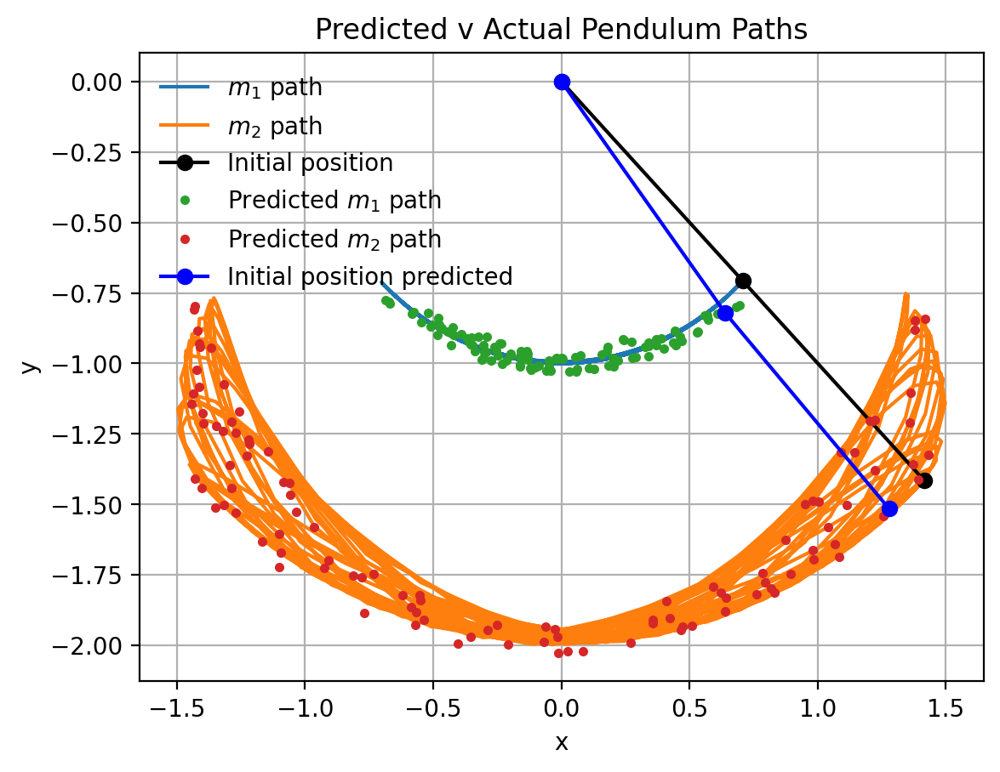

In [148]:
motion_LSTM = LSTM.predict_on_batch(X_test)

x1_predicted = motion_LSTM[:,0]
x2_predicted = motion_LSTM[:,1]
y1_predicted = motion_LSTM[:,2]
y2_predicted = motion_LSTM[:,3]

# Plotting the paths

fig, ax = plt.subplots()




# true data
ax.plot(x1, y1, label=r"$m_1$ path")
ax.plot(x2, y2, label=r"$m_2$ path")
ax.plot([0, x1[0], x2[0]], [0, y1[0], y2[0]], "-o", label="Initial position", c='k')

# LSTM path
ax.plot(x1_predicted, y1_predicted, label=r"Predicted $m_1$ path", marker='.', linestyle = '')
ax.plot(x2_predicted, y2_predicted, label=r"Predicted $m_2$ path", marker='.', linestyle = '')
ax.plot([0, x1_predicted[0], x2_predicted[0]], [0, y1_predicted[0], y2_predicted[0]], "-o", label="Initial position predicted", c='b')



ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_title('Predicted v Actual Pendulum Paths')
ax.legend(loc='upper left')
ax.grid(True)


From the Graph above, our LSTM did not predict our path well at all, so I am going to go back and increase the amount of layers in my network, we know there is no error in the actual learning process and it's still following some kind of projection, so what I will do is first increase the number of Epochs from 30, to say 40, 50 or 75
Then re test it but I highly doubt this will improve the trajectory, so I will then beef up the layers in the network and this should fix the trajectory

The accuracy and val accuracy improved but the graph is the same, let me investigate the x and y values from way above


It turns out the error had nothing to do with the layers, I accidently wrote the order of the coordinates wrong wayyy above, in my train model function, i wrote x1, x2, y1, y2 instead of x1, y1, x2, y2

As we can see from the fixed plot above the predicted paths from the LSTM is almost picture perfect in the sense that all the predicted plots are pretty much on top of the trajectory lines for the actual paths, all in all the LSTM model perfromed pretty well in these conditions, our window size was 20 timesteps so it seems to extrapolate quite well, let's move onto the next task.

### Task 2

How stable is your network to variations in initial conditions? Make a plot of  𝑥  and  𝑦  vs time to show the network prediction in comparison to the solution from solve_ivp

So we can create a function or simply manually redefine the intial paramters at each step, then we can re run the LSTM and see how well it is with dealing with different intial conditions

In [207]:
def to_cartesian(theta1, w1, theta2, w2, L1, L2):
    """ Transforms theta and omega to cartesian coordinates
    and velocities x1, y1, x2, y2, vx1, vy1, vx2, vy2
    """
    x1 = L1 * np.sin(theta1)
    y1 = -L1 * np.cos(theta1)
    x2 = x1 + L2 * np.sin(theta2)
    y2 = y1 - L2 * np.cos(theta2)
    vx1 = L1*np.cos(theta1)*w1
    vy1 = L1*np.sin(theta1)*w1
    vx2 = vx1 + L2*np.cos(theta2)*w2
    vy2 = vy1 + L2*np.sin(theta2)*w2

    print("Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:")
    print(x1.shape, y1.shape, x2.shape, y2.shape, vx1.shape, vy1.shape, vx2.shape, vy2.shape)

    return x1, y1, x2, y2, vx1, vy1, vx2, vy2

In [208]:
# create array of intial theta values then loop to plot the graphs

# Set up the initial conditions. Here we have lengths and masses
L1, L2 = 1., 1.
m1, m2 = 3., 1.
g = 9.81     # [m/s^2]. Gravitational acceleration

#Starting angles
#z0=[np.pi/4,0,np.pi/4,0]
#z0=[0.1,0,0.1,0]

#Time ranges
tmax, dt = 50, 0.1
t = np.arange(0, tmax+dt, dt)

z_param = [[np.pi/8,0,np.pi/8,0], [2*np.pi/8,0,2*np.pi/8,0], [3*np.pi/8,0,3*np.pi/8,0], [4*np.pi/8,0,4*np.pi/8,0], [5*np.pi/8,0,5*np.pi/8,0], [6*np.pi/8,0,6*np.pi/8,0], [7*np.pi/8,0,7*np.pi/8,0], [8*np.pi/8,0,8*np.pi/8,0]]


# Define a function returning the real path




def real_path(z0):
  """

  A function returning the true path for different theta values for intial conidions

  inputs:

  z0: array of initial theta values


  output:
  (x1,y1) and (x2,y2) position corrdinates for mass 1 & 2 respectively
  (vx1, vy1) & (vx2, vy2) velocities for mass 1&2 respectivley

  """

  # copying the solving of the intial value problems from above

  ret = solve_ivp(rhs, (0,tmax), z0, t_eval=t, args=(L1, L2, m1, m2, g))
  z=ret.y
  print("Shape of z array:", np.shape(z))


  # returns coord and velocities

  theta1, w1, theta2, w2 = z[0], z[1], z[2], z[3]
  x1, y1, x2, y2, vx1, vy1, vx2, vy2 = to_cartesian(theta1, w1, theta2, w2, L1, L2)

  print("Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:")
  print(x1.shape, y1.shape, x2.shape, y2.shape, vx1.shape, vy1.shape, vx2.shape, vy2.shape)


  return x1, y1, x2, y2, vx1, vy1, vx2, vy2




# Define a function to predict the trajectories/paths using all 8 initial theta values

def predicted_path_22(z0):

  """
  Returns the positions for the real motion and predited motions like earlier

  Inputs:
  z0: array for intial z values

  Outputs:
  real path for both masses: x1, y1, x2, y2
  predicted paths for both masses: x1_pred, y1_pred, x2_pred, y2_pred

  """

  x1, y1, x2, y2, vx1, vy1, vx2, vy2 = real_path(z0)

  # Predicted paths

  X_train, X_test, Y_train, Y_test = train_model_12(x1,y1, x2, y2, windowsize, offset)


  print("Shapes of real motion arrays:")
  print("x1:", x1.shape)
  print("y1:", y1.shape)
  print("x2:", x2.shape)
  print("y2:", y2.shape)
  print("vx1:", vx1.shape)
  print("vy1:", vy1.shape)
  print("vx2:", vx2.shape)
  print("vy2:", vy2.shape)



  motion_LSTM = LSTM.predict_on_batch(X_test)

  x1_predicted = motion_LSTM[:,0]
  x2_predicted = motion_LSTM[:,1]
  y1_predicted = motion_LSTM[:,2]
  y2_predicted = motion_LSTM[:,3]

  return x1, y1, x2, y2, x1_predicted, y1_predicted, x2_predicted, y2_predicted


# Now we can create a loop which will plot the 8 predicted and real path pairs on the same graph for all 8 different initial theta values







Shape of z array: (4, 501)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of real motion arrays:
x1: (501,)
y1: (501,)
x2: (501,)
y2: (501,)
vx1: (501,)
vy1: (501,)
vx2: (501,)
vy2: (501,)
Shape of z array: (4, 501)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of real motion arrays:
x1: (501,)
y1: (501,)
x2: (501,)
y2: (501,)
vx1: (501,)
vy1: (501,)
vx2: (501,)
vy2: (501,)
Shape of z array: (4, 501)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of real motion

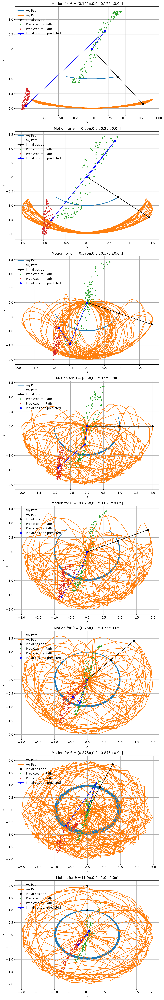

In [211]:
fig, axes = plt.subplots(len(z_param), 1, figsize=(8, 6 * len(z_param)))

for i, z in enumerate(z_param):
    x1, y1, x2, y2, x1_predicted, x2_predicted, y1_predicted, y2_predicted = predicted_path_22(z)

    # Plotting real path
    axes[i].plot(x1, y1, label=r"$m_1$ Path")
    axes[i].plot(x2, y2, label=r"$m_2$ Path")
    axes[i].plot([0, x1[0], x2[0]], [0, y1[0], y2[0]], "-o", label="Initial position", c='k')

    # Plotting predicted path
    axes[i].plot(x1_predicted, y1_predicted, label=r"Predicted $m_1$ Path", marker='.', linestyle='')
    axes[i].plot(x2_predicted, y2_predicted, label=r"Predicted $m_2$ Path", marker='.', linestyle='')
    axes[i].plot([0, x1_predicted[0], x2_predicted[0]], [0, y1_predicted[0], y2_predicted[0]], "-o", label="Initial position for LSTM", c='b')

    axes[i].set_xlabel('x')
    axes[i].set_ylabel('y')
    axes[i].set_title(f"Motion for θ = [{np.array(z)[0]/np.pi}π,{np.array(z)[1]/np.pi}π,{np.array(z)[2]/np.pi}π,{np.array(z)[3]/np.pi}π]")
    axes[i].legend(loc='upper left')
    axes[i].grid(True)

plt.tight_layout()
plt.show()

Shape of z array: (4, 501)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of real motion arrays:
x1: (501,)
y1: (501,)
x2: (501,)
y2: (501,)
vx1: (501,)
vy1: (501,)
vx2: (501,)
vy2: (501,)
Shape of z array: (4, 501)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of real motion arrays:
x1: (501,)
y1: (501,)
x2: (501,)
y2: (501,)
vx1: (501,)
vy1: (501,)
vx2: (501,)
vy2: (501,)
Shape of z array: (4, 501)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of real motion

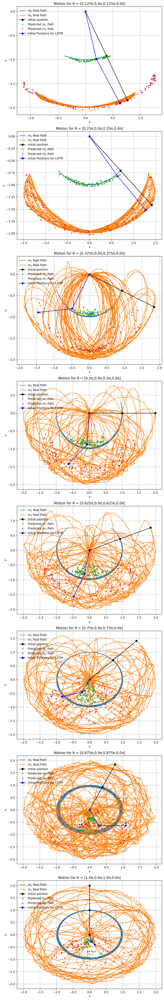

In [212]:

z_param = [[np.pi/8,0,np.pi/8,0], [2*np.pi/8,0,2*np.pi/8,0], [3*np.pi/8,0,3*np.pi/8,0], [4*np.pi/8,0,4*np.pi/8,0], [5*np.pi/8,0,5*np.pi/8,0], [6*np.pi/8,0,6*np.pi/8,0], [7*np.pi/8,0,7*np.pi/8,0], [8*np.pi/8,0,8*np.pi/8,0]]


fig, axes = plt.subplots(len(z_param), 1, figsize=(8, 6 * len(z_param)))

for i, z in enumerate(z_param):
    # Call predicted_path_22 function and unpack the returned values
    x1, y1, x2, y2, x1_predicted, y1_predicted, x2_predicted, y2_predicted = predicted_path_22(z)

    # Plotting real path
    axes[i].plot(x1, y1, label=r"$m_1$ Real Path")
    axes[i].plot(x2, y2, label=r"$m_2$ Real Path")
    axes[i].plot([0, x1[0], x2[0]], [0, y1[0], y2[0]], "-o", label="Initial position", c='k')

    # Plotting predicted path
    axes[i].plot(x1_predicted, y1_predicted, label=r"Predicted $m_1$ Path", marker='.', linestyle='')
    axes[i].plot(x2_predicted, y2_predicted, label=r"Predicted $m_2$ Path", marker='.', linestyle='')
    axes[i].plot([0, x1_predicted[0], x2_predicted[0]], [0, y1_predicted[0], y2_predicted[0]], "-o", label="Initial Positions for LSTM", c='b')

    axes[i].set_xlabel('x')
    axes[i].set_ylabel('y')
    axes[i].set_title(f"Motion for θ = [{np.array(z)[0]/np.pi}π,{np.array(z)[1]/np.pi}π,{np.array(z)[2]/np.pi}π,{np.array(z)[3]/np.pi}π]")
    axes[i].legend(loc='upper left')
    axes[i].grid(True)

plt.tight_layout()
plt.show()

We can see for each of the 8 plots above, as the initial theta values gets larger, the real paths become far more chaotic and I suppose the LMST would have a far harder time predicting the path however, we still see that the predicted paths are very close to the real paths and almost all the points are on top of the real paths f=or m1&m2

m2 has a far more chaotic path than m1 and the spread of the m2 predicted ponts is much larger, whereas the m1 points seemed to be clustered over a smaller area, but this is also because physically, the mass 1 is a 'shorter system' so the area covered in one period is far less (if you drew a trace of the string essentially)

Overall the model does pretty well in terms of stability and does not yet seem to break down, now if we were to adjust the window size and offset, I'm sure we could improve or worsen accuracy depending on how they're changed.

### Task 3

How far into the future can a network predict? Make a plot showing how the deviation between predicted position and actual position (from solve_ivp above) vary as a function of extrapolation time from  𝑡=𝑡0+20𝛿𝑡  to  𝑡=𝑡0+100𝛿𝑡 (e.g. for each extrapolation time, train a new version of the network and then plot the performance)

Repeat steps 1-3 for the initial conditions  𝑧0=[𝜋/2,0,𝜋/2,0]  which give a much more complex path.

Repeat steps 1-4 but only train your neural network on the cartesian coordinates of the mass  𝑚2  (i.e without showing your neural network the positions of the mass  𝑚1 )


So let's train the model again

In [217]:
# create array of intial theta values then loop to plot the graphs

# Set up the initial conditions. Here we have lengths and masses
L1, L2 = 1., 1.
m1, m2 = 3., 1.
g = 9.81     # [m/s^2]. Gravitational acceleration

#Starting angles
z0=[np.pi/4,0,np.pi/4,0]


#Time ranges
tmax, dt = 50, 0.1
t = np.arange(0, tmax+dt, dt)


ret = solve_ivp(rhs, (0,tmax), z0, t_eval=t, args=(L1, L2, m1, m2, g))
z=ret.y
print("Shape of z array:", np.shape(z))


# returns coord and velocities

theta1, w1, theta2, w2 = z[0], z[1], z[2], z[3]
x1, y1, x2, y2, vx1, vy1, vx2, vy2 = to_cartesian(theta1, w1, theta2, w2, L1, L2)

print("Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:")
print(x1.shape, y1.shape, x2.shape, y2.shape, vx1.shape, vy1.shape, vx2.shape, vy2.shape)


# empty arrays for loss
losses = []
val_losses=[]

offsets = np.arange(20,100,5)


#retraining the LSTM and test as in step 1 for each of the offsets
for offset in tqdm(offsets):
    LSTM = LSTM_model()

    # create the test and tran data
    X_train, X_test, Y_train, Y_test = train_model_12(x1, y1, x2, y2, windowsize, offset)

    loss, val_loss = train_model_121(LSTM, X_train, Y_train, X_test, Y_test,epochs=30)

    losses.append(loss)
    val_losses.append(val_loss)

Shape of z array: (4, 501)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)


  0%|          | 0/16 [00:00<?, ?it/s]

Model: "sequential_25"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_60 (LSTM)              (None, None, 100)         42000     
                                                                 
 lstm_61 (LSTM)              (None, None, 50)          30200     
                                                                 
 lstm_62 (LSTM)              (None, 100)               60400     
                                                                 
 dense_20 (Dense)            (None, 30)                3030      
                                                                 
 dense_21 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/30
11

  6%|▋         | 1/16 [00:47<11:57, 47.82s/it]

Model: "sequential_26"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_63 (LSTM)              (None, None, 100)         42000     
                                                                 
 lstm_64 (LSTM)              (None, None, 50)          30200     
                                                                 
 lstm_65 (LSTM)              (None, 100)               60400     
                                                                 
 dense_22 (Dense)            (None, 30)                3030      
                                                                 
 dense_23 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/30
10

 12%|█▎        | 2/16 [01:26<09:56, 42.62s/it]

Model: "sequential_27"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_66 (LSTM)              (None, None, 100)         42000     
                                                                 
 lstm_67 (LSTM)              (None, None, 50)          30200     
                                                                 
 lstm_68 (LSTM)              (None, 100)               60400     
                                                                 
 dense_24 (Dense)            (None, 30)                3030      
                                                                 
 dense_25 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/30
10

 19%|█▉        | 3/16 [02:15<09:49, 45.35s/it]

Model: "sequential_28"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_69 (LSTM)              (None, None, 100)         42000     
                                                                 
 lstm_70 (LSTM)              (None, None, 50)          30200     
                                                                 
 lstm_71 (LSTM)              (None, 100)               60400     
                                                                 
 dense_26 (Dense)            (None, 30)                3030      
                                                                 
 dense_27 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/30
10

 25%|██▌       | 4/16 [02:58<08:54, 44.51s/it]

Model: "sequential_29"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_72 (LSTM)              (None, None, 100)         42000     
                                                                 
 lstm_73 (LSTM)              (None, None, 50)          30200     
                                                                 
 lstm_74 (LSTM)              (None, 100)               60400     
                                                                 
 dense_28 (Dense)            (None, 30)                3030      
                                                                 
 dense_29 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/30
10

 31%|███▏      | 5/16 [03:40<07:57, 43.38s/it]

Model: "sequential_30"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_75 (LSTM)              (None, None, 100)         42000     
                                                                 
 lstm_76 (LSTM)              (None, None, 50)          30200     
                                                                 
 lstm_77 (LSTM)              (None, 100)               60400     
                                                                 
 dense_30 (Dense)            (None, 30)                3030      
                                                                 
 dense_31 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/30
10

 38%|███▊      | 6/16 [04:26<07:25, 44.53s/it]

Model: "sequential_31"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_78 (LSTM)              (None, None, 100)         42000     
                                                                 
 lstm_79 (LSTM)              (None, None, 50)          30200     
                                                                 
 lstm_80 (LSTM)              (None, 100)               60400     
                                                                 
 dense_32 (Dense)            (None, 30)                3030      
                                                                 
 dense_33 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/30
10

 44%|████▍     | 7/16 [05:13<06:47, 45.25s/it]

Model: "sequential_32"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_81 (LSTM)              (None, None, 100)         42000     
                                                                 
 lstm_82 (LSTM)              (None, None, 50)          30200     
                                                                 
 lstm_83 (LSTM)              (None, 100)               60400     
                                                                 
 dense_34 (Dense)            (None, 30)                3030      
                                                                 
 dense_35 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/30
10

 50%|█████     | 8/16 [05:55<05:54, 44.26s/it]

Model: "sequential_33"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_84 (LSTM)              (None, None, 100)         42000     
                                                                 
 lstm_85 (LSTM)              (None, None, 50)          30200     
                                                                 
 lstm_86 (LSTM)              (None, 100)               60400     
                                                                 
 dense_36 (Dense)            (None, 30)                3030      
                                                                 
 dense_37 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/30
10

 56%|█████▋    | 9/16 [06:42<05:15, 45.02s/it]

Model: "sequential_34"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_87 (LSTM)              (None, None, 100)         42000     
                                                                 
 lstm_88 (LSTM)              (None, None, 50)          30200     
                                                                 
 lstm_89 (LSTM)              (None, 100)               60400     
                                                                 
 dense_38 (Dense)            (None, 30)                3030      
                                                                 
 dense_39 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/30
10

 62%|██████▎   | 10/16 [07:23<04:22, 43.78s/it]

Model: "sequential_35"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_90 (LSTM)              (None, None, 100)         42000     
                                                                 
 lstm_91 (LSTM)              (None, None, 50)          30200     
                                                                 
 lstm_92 (LSTM)              (None, 100)               60400     
                                                                 
 dense_40 (Dense)            (None, 30)                3030      
                                                                 
 dense_41 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/30
9/

 69%|██████▉   | 11/16 [08:03<03:33, 42.67s/it]

Model: "sequential_36"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_93 (LSTM)              (None, None, 100)         42000     
                                                                 
 lstm_94 (LSTM)              (None, None, 50)          30200     
                                                                 
 lstm_95 (LSTM)              (None, 100)               60400     
                                                                 
 dense_42 (Dense)            (None, 30)                3030      
                                                                 
 dense_43 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/30
9/

 75%|███████▌  | 12/16 [08:41<02:45, 41.40s/it]

Model: "sequential_37"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_96 (LSTM)              (None, None, 100)         42000     
                                                                 
 lstm_97 (LSTM)              (None, None, 50)          30200     
                                                                 
 lstm_98 (LSTM)              (None, 100)               60400     
                                                                 
 dense_44 (Dense)            (None, 30)                3030      
                                                                 
 dense_45 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/30
9/

 81%|████████▏ | 13/16 [09:29<02:09, 43.18s/it]

Model: "sequential_38"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_99 (LSTM)              (None, None, 100)         42000     
                                                                 
 lstm_100 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_101 (LSTM)             (None, 100)               60400     
                                                                 
 dense_46 (Dense)            (None, 30)                3030      
                                                                 
 dense_47 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/30
9/

 88%|████████▊ | 14/16 [10:16<01:28, 44.47s/it]

Model: "sequential_39"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_102 (LSTM)             (None, None, 100)         42000     
                                                                 
 lstm_103 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_104 (LSTM)             (None, 100)               60400     
                                                                 
 dense_48 (Dense)            (None, 30)                3030      
                                                                 
 dense_49 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/30
9/

 94%|█████████▍| 15/16 [11:05<00:45, 45.71s/it]

Model: "sequential_40"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_105 (LSTM)             (None, None, 100)         42000     
                                                                 
 lstm_106 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_107 (LSTM)             (None, 100)               60400     
                                                                 
 dense_50 (Dense)            (None, 30)                3030      
                                                                 
 dense_51 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/30
9/

100%|██████████| 16/16 [11:51<00:00, 44.49s/it]


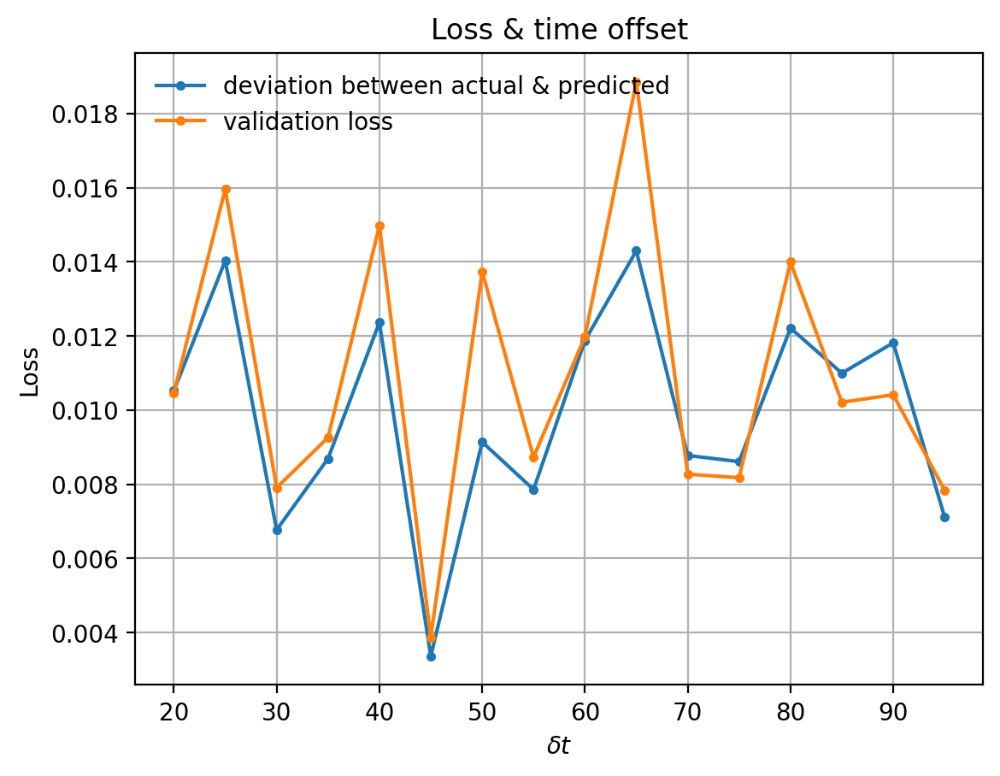

In [220]:
# Plotting the deviation between predicted and actual position

fig, ax = plt.subplots()

ax.plot(offsets, losses, label='deviation between actual & predicted', marker='.')
ax.plot(offsets, val_losses, label='validation loss', marker='.')
ax.set_title('Loss & time offset')
ax.set_xlabel(r'$\delta t$')
ax.set_ylabel('Loss')
ax.grid(True)
ax.legend(loc='upper left')

Now, window size is the number of steps in the past we use in our prediction and the offset is step size between consequitive input sequences

So a larger window size -> more data from past -> better prediction
Larger offset moves the position fowarrd by a larger timestep

So I'd excpect with a very small timestep, we'd be able to predict the next position very well and with a larger timestep, the accuracy would decrease and the loss would get larger, but it seems there is a weak correaltion between increasing the timestep and the change in losses, now it does make sense that losses are minimzed between a timestep fo 40 & 50 with a loss of about 0.003, and the greatest loss at about 65 which us about 5x greater than the minimum loss.

If the timestep is too small, say infitesimley small, we'd just assume a linear change in posiiton, eseentialy deltax+deltay, similar to first principles in calculus, so it makes sense that too small a step will not help predict the next step well, but ofcourse for huge timesteps, say we chosee 300, the model may find it had to extrapolate and predict the next moves, either way I am still quite surprised by the result.

###  The Finale

Repeat steps 1-3 for the initial conditions 𝑧0=[𝜋/2,0,𝜋/2,0] which give a much more complex path.
Repeat steps 1-4 but only train your neural network on the cartesian coordinates of the mass 𝑚2 (i.e without showing your neural network the positions of the mass 𝑚1 )
So let's train the model again

Shape of z array: (4, 501)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)


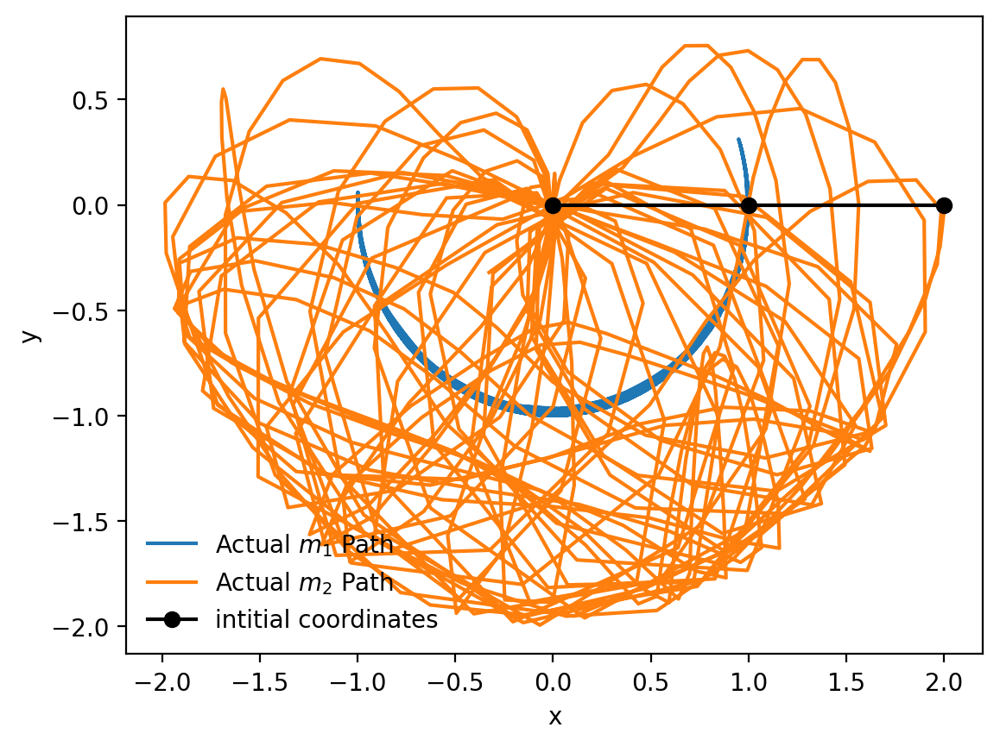

In [241]:
# create array of intial theta values then loop to plot the graphs

# Set up the initial conditions. Here we have lengths and masses
L1, L2 = 1., 1.
m1, m2 = 3., 1.
g = 9.81     # [m/s^2]. Gravitational acceleration

#Starting angles
z0=[np.pi/2,0,np.pi/2,0]


#Time ranges
tmax, dt = 50, 0.1
t = np.arange(0, tmax+dt, dt)


ret = solve_ivp(rhs, (0,tmax), z0, t_eval=t, args=(L1, L2, m1, m2, g))
z=ret.y
print("Shape of z array:", np.shape(z))

# returns coord and velocities

theta1, w1, theta2, w2 = z[0], z[1], z[2], z[3]
x1, y1, x2, y2, vx1, vy1, vx2, vy2 = to_cartesian(theta1, w1, theta2, w2, L1, L2)

print("Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:")
print(x1.shape, y1.shape, x2.shape, y2.shape, vx1.shape, vy1.shape, vx2.shape, vy2.shape)

fig,ax=plt.subplots()
ax.plot(x1, y1, label=r"Actual $m_1$ Path")
ax.plot(x2, y2, label=r"Actual $m_2$ Path")
ax.plot([0, x1[0], x2[0]], [0, y1[0], y2[0]], "-o", label="intitial coordinates", c='k')
plt.xlabel(r"x")
plt.ylabel(r"y")
ax.legend()

In [223]:
LSTM = LSTM_model()

## Set some values for wsize and offset

windowsize = 50
offset = 20

# Generate data to train the model using the function from earlier

X_train, X_test, Y_train, Y_test = train_model_12(x1,y1, x2, y2, windowsize, offset)

# print the shapes
print(f'{X_train.shape, Y_train.shape, X_test.shape, Y_test.shape} - array sizes')





train_model_121(LSTM, X_train, Y_train, X_test, Y_test,epochs=50)

losses.append(loss)
val_losses.append(val_loss)


Model: "sequential_41"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_108 (LSTM)             (None, None, 100)         42000     
                                                                 
 lstm_109 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_110 (LSTM)             (None, 100)               60400     
                                                                 
 dense_52 (Dense)            (None, 30)                3030      
                                                                 
 dense_53 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
((324, 50, 4)

A accuracy of 87%, A loss of 0.037 & val loss of 0.1, not bad considering the complexity of the path, let's move onto the next step

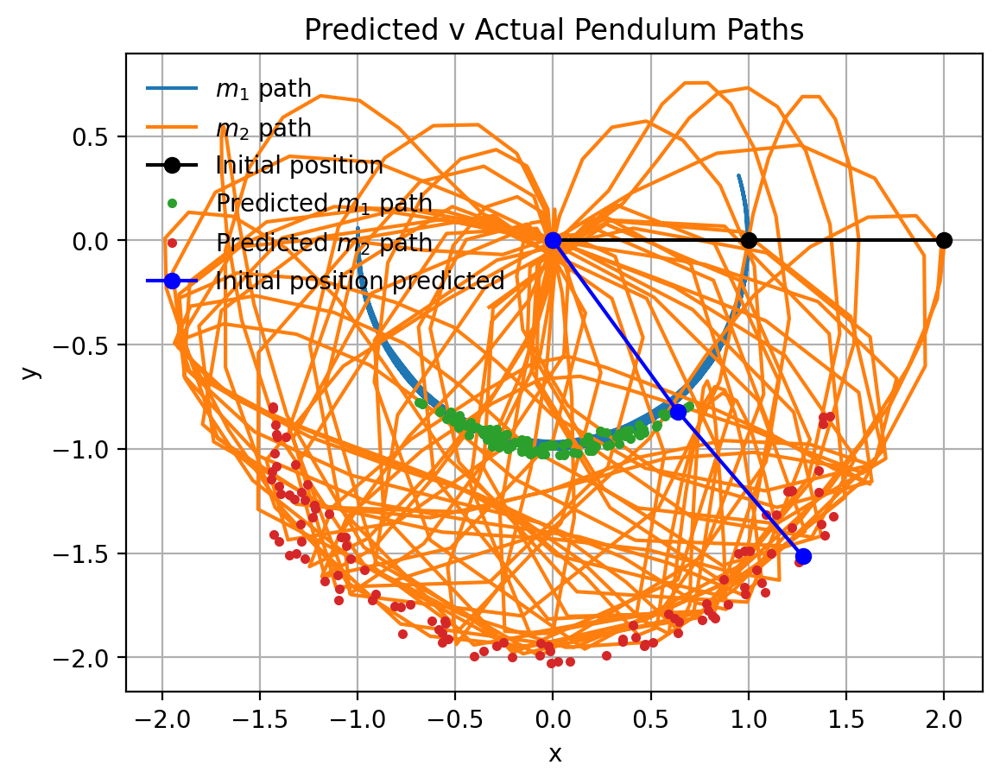

In [224]:
x1_predicted = motion_LSTM[:,0]
x2_predicted = motion_LSTM[:,1]
y1_predicted = motion_LSTM[:,2]
y2_predicted = motion_LSTM[:,3]

# Plotting the paths

fig, ax = plt.subplots()




# true data
ax.plot(x1, y1, label=r"$m_1$ path")
ax.plot(x2, y2, label=r"$m_2$ path")
ax.plot([0, x1[0], x2[0]], [0, y1[0], y2[0]], "-o", label="Initial position", c='k')

# LSTM path
ax.plot(x1_predicted, y1_predicted, label=r"Predicted $m_1$ path", marker='.', linestyle = '')
ax.plot(x2_predicted, y2_predicted, label=r"Predicted $m_2$ path", marker='.', linestyle = '')
ax.plot([0, x1_predicted[0], x2_predicted[0]], [0, y1_predicted[0], y2_predicted[0]], "-o", label="Initial position predicted", c='b')



ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_title('Predicted v Actual Pendulum Paths')
ax.legend(loc='upper left')
ax.grid(True)


Surprisingly the predicted paths of the masses sit nicely on top of the actual paths, again the mass 1 path is shorter and gence the points are closesly cluster together, also there's a heavier distribution in the middle, which makes sense as phsyically the mass spendes the most time near equilibrium position, this is not true for mass 2 though as there is essentially a second periodic function acting on it that's out of phase which is why the double penulum system leads to a complex paths, especially when both masses effect one another.

Whereas previously we ran a loop which retrained the model each time for the varying intial paramters, let's use the model above on the other different initial positions and see if the predictions are just as good as before, we should expect now but I wonder how much it'll decrease in it's ability to predict

Shape of z array: (4, 501)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of real motion arrays:
x1: (501,)
y1: (501,)
x2: (501,)
y2: (501,)
vx1: (501,)
vy1: (501,)
vx2: (501,)
vy2: (501,)
Shape of z array: (4, 501)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of real motion arrays:
x1: (501,)
y1: (501,)
x2: (501,)
y2: (501,)
vx1: (501,)
vy1: (501,)
vx2: (501,)
vy2: (501,)
Shape of z array: (4, 501)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of real motion

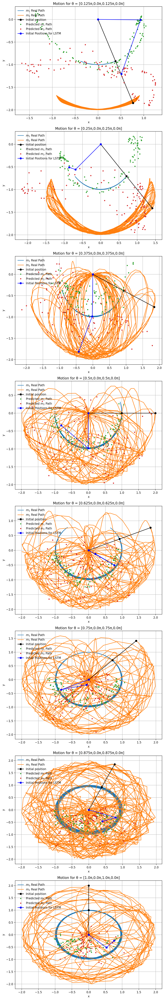

In [225]:



z_param = [[np.pi/8,0,np.pi/8,0], [2*np.pi/8,0,2*np.pi/8,0], [3*np.pi/8,0,3*np.pi/8,0], [4*np.pi/8,0,4*np.pi/8,0], [5*np.pi/8,0,5*np.pi/8,0], [6*np.pi/8,0,6*np.pi/8,0], [7*np.pi/8,0,7*np.pi/8,0], [8*np.pi/8,0,8*np.pi/8,0]]


fig, axes = plt.subplots(len(z_param), 1, figsize=(8, 6 * len(z_param)))

for i, z in enumerate(z_param):
    # Call predicted_path_22 function and unpack the returned values
    x1, y1, x2, y2, x1_predicted, y1_predicted, x2_predicted, y2_predicted = predicted_path_22(z)

    # Plotting real path
    axes[i].plot(x1, y1, label=r"$m_1$ Real Path")
    axes[i].plot(x2, y2, label=r"$m_2$ Real Path")
    axes[i].plot([0, x1[0], x2[0]], [0, y1[0], y2[0]], "-o", label="Initial position", c='k')

    # Plotting predicted path
    axes[i].plot(x1_predicted, y1_predicted, label=r"Predicted $m_1$ Path", marker='.', linestyle='')
    axes[i].plot(x2_predicted, y2_predicted, label=r"Predicted $m_2$ Path", marker='.', linestyle='')
    axes[i].plot([0, x1_predicted[0], x2_predicted[0]], [0, y1_predicted[0], y2_predicted[0]], "-o", label="Initial Positions for LSTM", c='b')

    axes[i].set_xlabel('x')
    axes[i].set_ylabel('y')
    axes[i].set_title(f"Motion for θ = [{np.array(z)[0]/np.pi}π,{np.array(z)[1]/np.pi}π,{np.array(z)[2]/np.pi}π,{np.array(z)[3]/np.pi}π]")
    axes[i].legend(loc='upper left')
    axes[i].grid(True)

plt.tight_layout()
plt.show()

So we see a model which is far inferior at predicting the paths of the masses the furhter away the initial theta valeus stray from the conditions in which we trained our model on, the pi/2 intial coditions ofcourse performs the best as the model was trained on this and the further we get the more inaccurate.
However for mass 2 pi seems a better prediction than pi/8, this may just be because the pi path is far more chaotic and it covers more area, thus if we just randomly threw darts at it, we're more likely to be more accurate, and we can also see for mass 1, the pi/8 prediction is far better than the pi path.

Now let's investigate the loss as we vary the timestep again...

In [228]:
# pi/2 initial condition

z0=[np.pi/2,0,np.pi/2,0]

# empty arrays for loss
losses = []
val_losses=[]

# increase timestep from 20 -> 100 in steps of 5

offsets = np.arange(20,100,5)


#retraining the LSTM and test as in step 1 for each of the offsets
for offset in tqdm(offsets):
    LSTM = LSTM_model()

    # create the test and tran data
    X_train, X_test, Y_train, Y_test = train_model_12(x1, y1, x2, y2, windowsize, offset)

    # 50 epochs this time vs 30 so gonna take years..
    loss, val_loss = train_model_121(LSTM, X_train, Y_train, X_test, Y_test,epochs=50)

    losses.append(loss)
    val_losses.append(val_loss)

  0%|          | 0/16 [00:00<?, ?it/s]

Model: "sequential_43"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_114 (LSTM)             (None, None, 100)         42000     
                                                                 
 lstm_115 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_116 (LSTM)             (None, 100)               60400     
                                                                 
 dense_56 (Dense)            (None, 30)                3030      
                                                                 
 dense_57 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
11

  6%|▋         | 1/16 [01:16<19:07, 76.50s/it]

Model: "sequential_44"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_117 (LSTM)             (None, None, 100)         42000     
                                                                 
 lstm_118 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_119 (LSTM)             (None, 100)               60400     
                                                                 
 dense_58 (Dense)            (None, 30)                3030      
                                                                 
 dense_59 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
10

 12%|█▎        | 2/16 [02:16<15:31, 66.54s/it]

Model: "sequential_45"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_120 (LSTM)             (None, None, 100)         42000     
                                                                 
 lstm_121 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_122 (LSTM)             (None, 100)               60400     
                                                                 
 dense_60 (Dense)            (None, 30)                3030      
                                                                 
 dense_61 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
10

 19%|█▉        | 3/16 [03:43<16:30, 76.16s/it]

Model: "sequential_46"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_123 (LSTM)             (None, None, 100)         42000     
                                                                 
 lstm_124 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_125 (LSTM)             (None, 100)               60400     
                                                                 
 dense_62 (Dense)            (None, 30)                3030      
                                                                 
 dense_63 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
10

 25%|██▌       | 4/16 [04:47<14:15, 71.26s/it]

Model: "sequential_47"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_126 (LSTM)             (None, None, 100)         42000     
                                                                 
 lstm_127 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_128 (LSTM)             (None, 100)               60400     
                                                                 
 dense_64 (Dense)            (None, 30)                3030      
                                                                 
 dense_65 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
10

 31%|███▏      | 5/16 [06:15<14:08, 77.16s/it]

Model: "sequential_48"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_129 (LSTM)             (None, None, 100)         42000     
                                                                 
 lstm_130 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_131 (LSTM)             (None, 100)               60400     
                                                                 
 dense_66 (Dense)            (None, 30)                3030      
                                                                 
 dense_67 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
10

 38%|███▊      | 6/16 [07:42<13:28, 80.81s/it]

Model: "sequential_49"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_132 (LSTM)             (None, None, 100)         42000     
                                                                 
 lstm_133 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_134 (LSTM)             (None, 100)               60400     
                                                                 
 dense_68 (Dense)            (None, 30)                3030      
                                                                 
 dense_69 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
10

 44%|████▍     | 7/16 [09:12<12:34, 83.78s/it]

Model: "sequential_50"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_135 (LSTM)             (None, None, 100)         42000     
                                                                 
 lstm_136 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_137 (LSTM)             (None, 100)               60400     
                                                                 
 dense_70 (Dense)            (None, 30)                3030      
                                                                 
 dense_71 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
10

 50%|█████     | 8/16 [10:16<10:18, 77.26s/it]

Model: "sequential_51"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_138 (LSTM)             (None, None, 100)         42000     
                                                                 
 lstm_139 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_140 (LSTM)             (None, 100)               60400     
                                                                 
 dense_72 (Dense)            (None, 30)                3030      
                                                                 
 dense_73 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
10

 56%|█████▋    | 9/16 [11:43<09:23, 80.45s/it]

Model: "sequential_52"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_141 (LSTM)             (None, None, 100)         42000     
                                                                 
 lstm_142 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_143 (LSTM)             (None, 100)               60400     
                                                                 
 dense_74 (Dense)            (None, 30)                3030      
                                                                 
 dense_75 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
10

 62%|██████▎   | 10/16 [12:46<07:29, 74.90s/it]

Model: "sequential_53"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_144 (LSTM)             (None, None, 100)         42000     
                                                                 
 lstm_145 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_146 (LSTM)             (None, 100)               60400     
                                                                 
 dense_76 (Dense)            (None, 30)                3030      
                                                                 
 dense_77 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
9/

 69%|██████▉   | 11/16 [13:43<05:47, 69.57s/it]

Model: "sequential_54"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_147 (LSTM)             (None, None, 100)         42000     
                                                                 
 lstm_148 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_149 (LSTM)             (None, 100)               60400     
                                                                 
 dense_78 (Dense)            (None, 30)                3030      
                                                                 
 dense_79 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
9/

 75%|███████▌  | 12/16 [14:41<04:24, 66.05s/it]

Model: "sequential_55"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_150 (LSTM)             (None, None, 100)         42000     
                                                                 
 lstm_151 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_152 (LSTM)             (None, 100)               60400     
                                                                 
 dense_80 (Dense)            (None, 30)                3030      
                                                                 
 dense_81 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
9/

 81%|████████▏ | 13/16 [16:09<03:37, 72.55s/it]

Model: "sequential_56"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_153 (LSTM)             (None, None, 100)         42000     
                                                                 
 lstm_154 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_155 (LSTM)             (None, 100)               60400     
                                                                 
 dense_82 (Dense)            (None, 30)                3030      
                                                                 
 dense_83 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
9/

 88%|████████▊ | 14/16 [17:12<02:19, 69.73s/it]

Model: "sequential_57"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_156 (LSTM)             (None, None, 100)         42000     
                                                                 
 lstm_157 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_158 (LSTM)             (None, 100)               60400     
                                                                 
 dense_84 (Dense)            (None, 30)                3030      
                                                                 
 dense_85 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
9/

 94%|█████████▍| 15/16 [18:40<01:15, 75.26s/it]

Model: "sequential_58"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_159 (LSTM)             (None, None, 100)         42000     
                                                                 
 lstm_160 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_161 (LSTM)             (None, 100)               60400     
                                                                 
 dense_86 (Dense)            (None, 30)                3030      
                                                                 
 dense_87 (Dense)            (None, 4)                 124       
                                                                 
Total params: 135754 (530.29 KB)
Trainable params: 135754 (530.29 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
9/

100%|██████████| 16/16 [20:08<00:00, 75.53s/it]


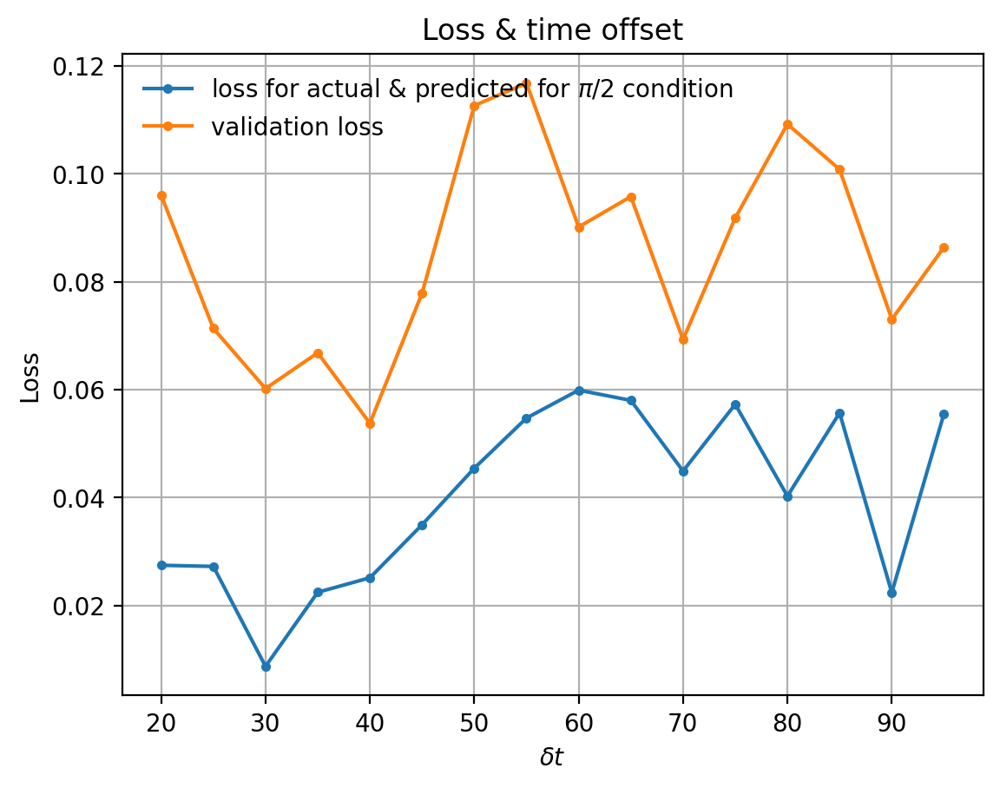

In [233]:
# Plotting the deviation between predicted and actual position for model trained on pi/2 initial condition

fig, ax = plt.subplots()

ax.plot(offsets, losses, label='loss for actual & predicted for $\pi$/2 condition', marker='.')
ax.plot(offsets, val_losses, label='validation loss', marker='.')
ax.set_title('Loss & time offset')
ax.set_xlabel(r'$\delta t$')
ax.set_ylabel('Loss')
ax.grid(True)
ax.legend(loc='upper left')

In contrast to last time we see a greater deviation in the loss as we increase the timestep, before there was a weak correlation and it didn't say much except that 40-50 was the ideal range, anyway here there is a not so clear but  a positive coorelation nevertheless, as we increase the timestep, the loss increases, the fact that the system becomes so complex is porbably why the loss increases faster, we also see a slight dip showing a ideal timestep of 30, shorter than before, makes sense, more complex motions, less harmonci oscilator-esque so a timestep too small will increase the loss, either way we see 30-35 is the sweet spot

### Part 5 or 500 or something


Basically we just want the model trained on mass 2, simple change to code, very long run time coming up...

So essentially just delete the actual position data and feed only mass 2 coordinates into the model, okay let's start by redifing all functions by just removing the mass 1 data when needed.

In [250]:
# part 2

def train_model_127(x2, y2, windowsize, offset):

  """

  Trains the model using only mass 2 of the double pendulumn with time

  inputs: (r2, windsize, offset)
  positions : - x & y coord for both masses over time, I just wrote r for x1,y1 etc
  Windowsize: - Number of samples used to train the network
  Offset:     - Number of samples we want to predict in the future

  Outputs: x and y values for training and testing on the model


  """
  # Let's reshape our arrays - bye-bye x1 & y1


  x2_inp, x2_lab = shapeArray(x2, windowsize, offset)
  y2_inp, y2_lab = shapeArray(y2, windowsize, offset)

  # Let's stack arrays so they can fit into the training model

  x = np.stack((x2_inp, y2_inp), axis=-1)
  y = np.stack((x2_lab, y2_lab), axis=-1)

  X_train, X_test, y_train, y_test = train_test_split(x, y, random_state=42)

  return X_train, X_test, y_train, y_test

In [252]:
## Now let's create our LSTM network
def LSTM_model_2():

  model = keras.models.Sequential()
  model.add(keras.layers.LSTM(100,input_shape=(None,2),return_sequences=True))
  model.add(keras.layers.LSTM(50, return_sequences = True))
  model.add(keras.layers.LSTM(100, return_sequences = False))
  model.add(keras.layers.Dense(30,activation="relu"))
  model.add(keras.layers.Dense(2,activation="linear"))

  model.compile(loss='mean_squared_error',optimizer='adam', metrics=['accuracy'])
  model.summary()

  return model


#intial, 16, 8 and 4 layers, 2180 param and output layer of 2
#now, 100, 50, 100, 30, 4, 135754 param and output 2 now as only x2,y2


In [253]:
LSTM = LSTM_model_2()

Model: "sequential_61"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_168 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_169 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_170 (LSTM)             (None, 100)               60400     
                                                                 
 dense_92 (Dense)            (None, 30)                3030      
                                                                 
 dense_93 (Dense)            (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


(4, 501)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)


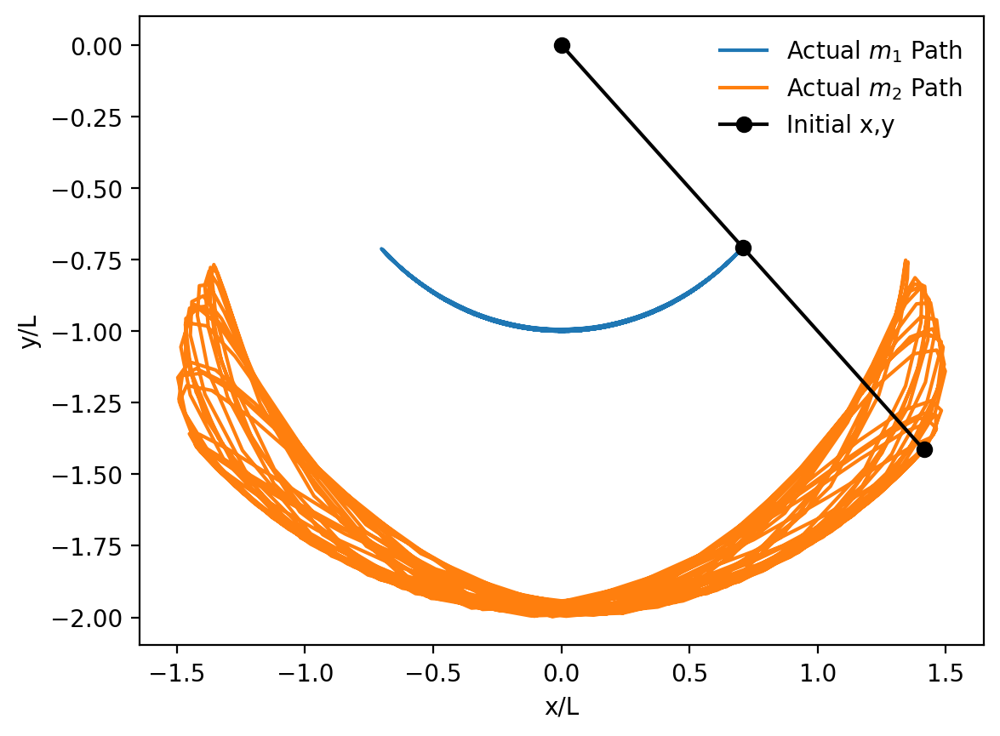

In [254]:
L1, L2 = 1., 1.
m1, m2 = 3., 1.
g = 9.81     # [m/s^2]. Gravitational acceleration

#Starting angles
z0=[np.pi/4,0,np.pi/4,0]
#z0=[0.1,0,0.1,0]

#Time ranges
tmax, dt = 50, 0.1
t = np.arange(0, tmax+dt, dt)

#initial value problem
ret = solve_ivp(rhs, (0,tmax), z0, t_eval=t, args=(L1, L2, m1, m2, g))
z=ret.y
print(np.shape(z))

# Extract result
theta1, w1, theta2, w2 = z[0], z[1], z[2], z[3]
x1, y1, x2, y2, vx1, vy1, vx2, vy2 = to_cartesian(theta1, w1, theta2, w2, L1, L2)

fig,ax=plt.subplots()
ax.plot(x1, y1, label=r"Actual $m_1$ Path")
ax.plot(x2, y2, label=r"Actual $m_2$ Path")
ax.plot([0, x1[0], x2[0]], [0, y1[0], y2[0]], "-o", label="Initial x,y", c='k')
plt.xlabel(r"x/L")
plt.ylabel(r"y/L")
ax.legend()

In [255]:
# Monsterous run time coming up, let's retrain the LSTM model only seeing the path of mass 2


# Set the offset and windowsize
windowsize = 50
offset = 20


# create the test and tran data
X_train, X_test, Y_train, Y_test = train_model_127(x2, y2, windowsize, offset)

# print the shapes
print(f'{X_train.shape, Y_train.shape, X_test.shape, Y_test.shape} shapes are as expected')

train_model_121(LSTM, X_train, Y_train, X_test, Y_test, epochs=50)

((324, 50, 2), (324, 2), (108, 50, 2), (108, 2)) shapes are as expected
Epoch 1/50
11/11 - 9s - loss: 0.9671 - accuracy: 0.8426 - val_loss: 0.4903 - val_accuracy: 0.8241 - 9s/epoch - 851ms/step
Epoch 2/50
11/11 - 1s - loss: 0.4439 - accuracy: 0.8426 - val_loss: 0.1961 - val_accuracy: 0.8241 - 1s/epoch - 97ms/step
Epoch 3/50
11/11 - 1s - loss: 0.1219 - accuracy: 0.8920 - val_loss: 0.0913 - val_accuracy: 0.8981 - 1s/epoch - 103ms/step
Epoch 4/50
11/11 - 1s - loss: 0.0685 - accuracy: 0.8673 - val_loss: 0.0744 - val_accuracy: 0.8241 - 1s/epoch - 101ms/step
Epoch 5/50
11/11 - 1s - loss: 0.0533 - accuracy: 0.8765 - val_loss: 0.0468 - val_accuracy: 0.9259 - 1s/epoch - 98ms/step
Epoch 6/50
11/11 - 1s - loss: 0.0386 - accuracy: 0.8920 - val_loss: 0.0339 - val_accuracy: 0.9259 - 1s/epoch - 102ms/step
Epoch 7/50
11/11 - 1s - loss: 0.0291 - accuracy: 0.9383 - val_loss: 0.0239 - val_accuracy: 0.9167 - 1s/epoch - 100ms/step
Epoch 8/50
11/11 - 2s - loss: 0.0230 - accuracy: 0.9414 - val_loss: 0.0196 -

(0.0018275707261636853, 0.0031763645820319653)

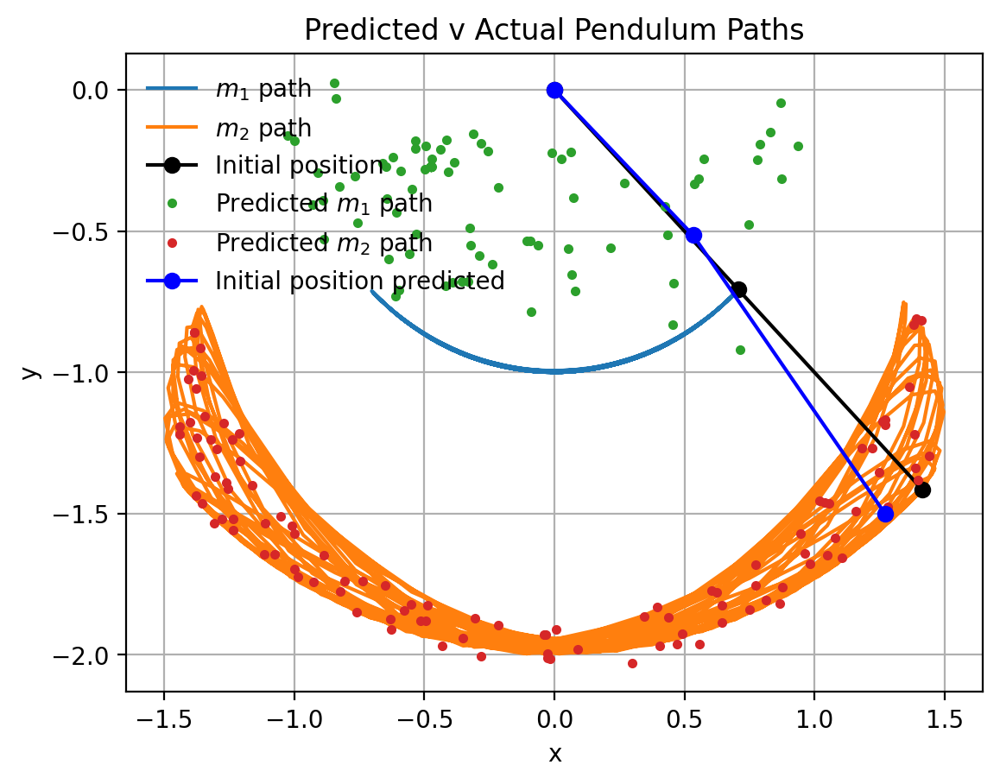

In [257]:
motion_LSTM = LSTM.predict_on_batch(X_test)


x2_predicted = motion_LSTM[:,0]

y2_predicted = motion_LSTM[:,1]

# Plotting the paths

fig, ax = plt.subplots()




# true data
ax.plot(x1, y1, label=r"$m_1$ path")
ax.plot(x2, y2, label=r"$m_2$ path")
ax.plot([0, x1[0], x2[0]], [0, y1[0], y2[0]], "-o", label="Initial position", c='k')

# LSTM path
ax.plot(x1_predicted, y1_predicted, label=r"Predicted $m_1$ path", marker='.', linestyle = '')
ax.plot(x2_predicted, y2_predicted, label=r"Predicted $m_2$ path", marker='.', linestyle = '')
ax.plot([0, x1_predicted[0], x2_predicted[0]], [0, y1_predicted[0], y2_predicted[0]], "-o", label="Initial position predicted", c='b')



ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_title('Predicted v Actual Pendulum Paths')
ax.legend(loc='upper left')
ax.grid(True)

Similar to before, predicts m2 very well, no over or underfitting present, m1 predicted path is non existent because we didn't train it on that or do we care about it anymore, let's move on

In [267]:
# Set up the initial conditions. Here we have lengths and masses
L1, L2 = 1., 1.
m1, m2 = 3., 1.
g = 9.81     # [m/s^2]. Gravitational acceleration

#Starting angles
#z0=[np.pi/4,0,np.pi/4,0]
#z0=[0.1,0,0.1,0]

#Time ranges
tmax, dt = 50, 0.1
t = np.arange(0, tmax+dt, dt)

z_param = [[np.pi/8,0,np.pi/8,0], [2*np.pi/8,0,2*np.pi/8,0], [3*np.pi/8,0,3*np.pi/8,0], [4*np.pi/8,0,4*np.pi/8,0], [5*np.pi/8,0,5*np.pi/8,0], [6*np.pi/8,0,6*np.pi/8,0], [7*np.pi/8,0,7*np.pi/8,0], [8*np.pi/8,0,8*np.pi/8,0]]


# Define a function returning the real path




def real_path(z0):
  """

  A function returning the true path for different theta values for intial conidions

  inputs:

  z0: array of initial theta values


  output:
  (x1,y1) and (x2,y2) position corrdinates for mass 1 & 2 respectively
  (vx1, vy1) & (vx2, vy2) velocities for mass 1&2 respectivley

  """

  # copying the solving of the intial value problems from above

  ret = solve_ivp(rhs, (0,tmax), z0, t_eval=t, args=(L1, L2, m1, m2, g))
  z=ret.y
  print("Shape of z array:", np.shape(z))


  # returns coord and velocities

  theta1, w1, theta2, w2 = z[0], z[1], z[2], z[3]
  x1, y1, x2, y2, vx1, vy1, vx2, vy2 = to_cartesian(theta1, w1, theta2, w2, L1, L2)

  print("Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:")
  print(x1.shape, y1.shape, x2.shape, y2.shape, vx1.shape, vy1.shape, vx2.shape, vy2.shape)


  return x1, y1, x2, y2, vx1, vy1, vx2, vy2




# Define a function to predict the trajectories/paths using all 8 initial theta values

def predicted_path_227(z0):

  """
  Returns the positions for the real motion and predited motions like earlier

  Inputs:
  z0: array for intial z values

  Outputs:
  real path for both masses: x1, y1, x2, y2
  predicted paths for both masses: x1_pred, y1_pred, x2_pred, y2_pred

  """

  x1, y1, x2, y2, vx1, vy1, vx2, vy2 = real_path(z0)

  # Predicted paths

  X_train, X_test, Y_train, Y_test = train_model_127(x2, y2, windowsize, offset)


  print("Shapes of real motion arrays:")
  print("x1:", x1.shape)
  print("y1:", y1.shape)
  print("x2:", x2.shape)
  print("y2:", y2.shape)
  print("vx1:", vx1.shape)
  print("vy1:", vy1.shape)
  print("vx2:", vx2.shape)
  print("vy2:", vy2.shape)



  motion_LSTM = LSTM.predict_on_batch(X_test)


  x2_predicted = motion_LSTM[:,0]

  y2_predicted = motion_LSTM[:,1]

  return x1, y1, x2, y2, x2_predicted, y2_predicted

Shape of z array: (4, 501)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of real motion arrays:
x1: (501,)
y1: (501,)
x2: (501,)
y2: (501,)
vx1: (501,)
vy1: (501,)
vx2: (501,)
vy2: (501,)


InvalidArgumentError: Graph execution error:

Detected at node while/MatMul defined at (most recent call last):
  File "/usr/lib/python3.10/runpy.py", line 196, in _run_module_as_main

  File "/usr/lib/python3.10/runpy.py", line 86, in _run_code

  File "/usr/local/lib/python3.10/dist-packages/colab_kernel_launcher.py", line 37, in <module>

  File "/usr/local/lib/python3.10/dist-packages/traitlets/config/application.py", line 992, in launch_instance

  File "/usr/local/lib/python3.10/dist-packages/ipykernel/kernelapp.py", line 619, in start

  File "/usr/local/lib/python3.10/dist-packages/tornado/platform/asyncio.py", line 195, in start

  File "/usr/lib/python3.10/asyncio/base_events.py", line 603, in run_forever

  File "/usr/lib/python3.10/asyncio/base_events.py", line 1909, in _run_once

  File "/usr/lib/python3.10/asyncio/events.py", line 80, in _run

  File "/usr/local/lib/python3.10/dist-packages/tornado/ioloop.py", line 685, in <lambda>

  File "/usr/local/lib/python3.10/dist-packages/tornado/ioloop.py", line 738, in _run_callback

  File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 825, in inner

  File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 786, in run

  File "/usr/local/lib/python3.10/dist-packages/ipykernel/kernelbase.py", line 361, in process_one

  File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 234, in wrapper

  File "/usr/local/lib/python3.10/dist-packages/ipykernel/kernelbase.py", line 261, in dispatch_shell

  File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 234, in wrapper

  File "/usr/local/lib/python3.10/dist-packages/ipykernel/kernelbase.py", line 539, in execute_request

  File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 234, in wrapper

  File "/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py", line 302, in do_execute

  File "/usr/local/lib/python3.10/dist-packages/ipykernel/zmqshell.py", line 539, in run_cell

  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 2975, in run_cell

  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3030, in _run_cell

  File "/usr/local/lib/python3.10/dist-packages/IPython/core/async_helpers.py", line 78, in _pseudo_sync_runner

  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3257, in run_cell_async

  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3473, in run_ast_nodes

  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3553, in run_code

  File "<ipython-input-260-ed8b021f86f4>", line 8, in <cell line: 6>

  File "<ipython-input-208-3c618d9f9fe0>", line 96, in predicted_path_22

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 2880, in predict_on_batch

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 2440, in predict_function

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 2425, in step_function

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 2413, in run_step

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 2381, in predict_step

  File "/usr/local/lib/python3.10/dist-packages/keras/src/utils/traceback_utils.py", line 65, in error_handler

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 590, in __call__

  File "/usr/local/lib/python3.10/dist-packages/keras/src/utils/traceback_utils.py", line 65, in error_handler

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/base_layer.py", line 1149, in __call__

  File "/usr/local/lib/python3.10/dist-packages/keras/src/utils/traceback_utils.py", line 96, in error_handler

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/sequential.py", line 398, in call

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/functional.py", line 515, in call

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/functional.py", line 672, in _run_internal_graph

  File "/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/base_rnn.py", line 556, in __call__

  File "/usr/local/lib/python3.10/dist-packages/keras/src/utils/traceback_utils.py", line 65, in error_handler

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/base_layer.py", line 1149, in __call__

  File "/usr/local/lib/python3.10/dist-packages/keras/src/utils/traceback_utils.py", line 96, in error_handler

  File "/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/lstm.py", line 749, in call

  File "/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/lstm.py", line 1339, in lstm_with_backend_selection

  File "/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/lstm.py", line 981, in standard_lstm

  File "/usr/local/lib/python3.10/dist-packages/keras/src/backend.py", line 5168, in rnn

  File "/usr/local/lib/python3.10/dist-packages/keras/src/backend.py", line 5147, in _step

  File "/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/lstm.py", line 967, in step

  File "/usr/local/lib/python3.10/dist-packages/keras/src/backend.py", line 2463, in dot

Matrix size-incompatible: In[0]: [108,4], In[1]: [2,400]
	 [[{{node while/MatMul}}]]
	 [[sequential_61/lstm_168/PartitionedCall]] [Op:__inference_predict_function_534340]

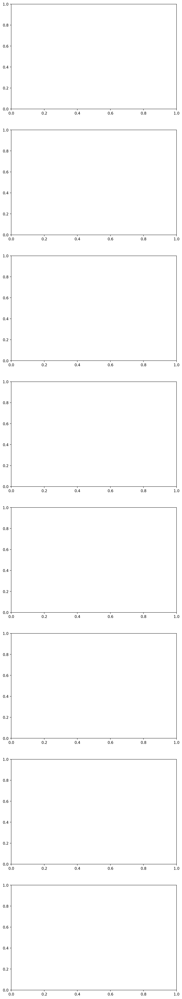

In [269]:
_param = [[np.pi/8,0,np.pi/8,0], [2*np.pi/8,0,2*np.pi/8,0], [3*np.pi/8,0,3*np.pi/8,0], [4*np.pi/8,0,4*np.pi/8,0], [5*np.pi/8,0,5*np.pi/8,0], [6*np.pi/8,0,6*np.pi/8,0], [7*np.pi/8,0,7*np.pi/8,0], [8*np.pi/8,0,8*np.pi/8,0]]


fig, axes = plt.subplots(len(z_param), 1, figsize=(8, 6 * len(z_param)))

for i, z in enumerate(z_param):
    # Call predicted_path_22 function and unpack the returned values
    x1, y1, x2, y2, x1_predicted, y1_predicted, x2_predicted, y2_predicted = predicted_path_22(z)

    # Plotting real path
    axes[i].plot(x1, y1, label=r"$m_1$ Real Path")
    axes[i].plot(x2, y2, label=r"$m_2$ Real Path")
    axes[i].plot([0, x1[0], x2[0]], [0, y1[0], y2[0]], "-o", label="Initial positions", c='k')

    # Plotting predicted path
    axes[i].plot(x1_predicted, y1_predicted, label=r"Predicted $m_1$ Path", marker='.', linestyle='')
    axes[i].plot(x2_predicted, y2_predicted, label=r"Predicted $m_2$ Path", marker='.', linestyle='')
    axes[i].plot([0, x1_predicted[0], x2_predicted[0]], [0, y1_predicted[0], y2_predicted[0]], "-o", label="Initial Positions for LSTM", c='b')

    axes[i].set_xlabel('x')
    axes[i].set_ylabel('y')
    axes[i].set_title(f"Motion for θ = [{np.array(z)[0]/np.pi}π,{np.array(z)[1]/np.pi}π,{np.array(z)[2]/np.pi}π,{np.array(z)[3]/np.pi}π]")
    axes[i].legend(loc='upper left')
    axes[i].grid(True)

plt.tight_layout()
plt.show()

Shape of z array: (4, 501)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of real motion arrays:
x1: (501,)
y1: (501,)
x2: (501,)
y2: (501,)
vx1: (501,)
vy1: (501,)
vx2: (501,)
vy2: (501,)
Shape of z array: (4, 501)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of real motion arrays:
x1: (501,)
y1: (501,)
x2: (501,)
y2: (501,)
vx1: (501,)
vy1: (501,)
vx2: (501,)
vy2: (501,)
Shape of z array: (4, 501)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of real motion

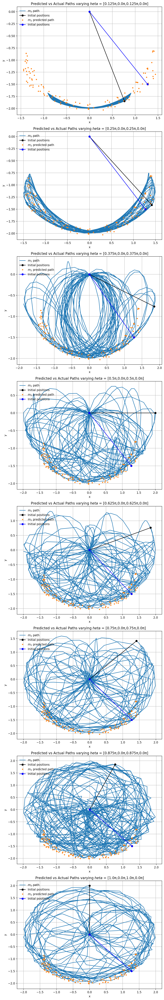

In [270]:
z_param = [[np.pi/8,0,np.pi/8,0], [2*np.pi/8,0,2*np.pi/8,0], [3*np.pi/8,0,3*np.pi/8,0], [4*np.pi/8,0,4*np.pi/8,0], [5*np.pi/8,0,5*np.pi/8,0], [6*np.pi/8,0,6*np.pi/8,0], [7*np.pi/8,0,7*np.pi/8,0], [8*np.pi/8,0,8*np.pi/8,0]]


fig, axes = plt.subplots(len(z_param), 1, figsize=(8, 6 * len(z_param)))

for i, z in enumerate(z_param):
    x1, y1, x2, y2, x2_p, y2_p = predicted_path_227(z)

    # Plotting true data
    axes[i].plot(x2, y2, label=r"$m_2$ path")
    axes[i].plot([0, x2[0]], [0, y2[0]], "-o", label="Initial positions", c='k')

    # Plotting predicted data
    axes[i].plot(x2_predicted, y2_predicted, label=r"$m_2$ predicted path", marker='.', linestyle='')
    axes[i].plot([0, x2_predicted[0]], [0, y2_predicted[0]], "-o", label="Initial positions", c='b')

    axes[i].set_xlabel('x')
    axes[i].set_ylabel('y')
    axes[i].set_title(f"Predicted vs Actual Paths varying $/theta$ = [{np.array(z)[0]/np.pi}π,{np.array(z)[1]/np.pi}π,{np.array(z)[2]/np.pi}π,{np.array(z)[3]/np.pi}π]")
    axes[i].legend(loc='upper left')
    axes[i].grid(True)

plt.tight_layout()
plt.show()

I don't know what to exactly think of these plots.. but the mass 2 predicted position just seems to be similar for all varying values of theta, funny enough when the initial paramters ake the path go WILD, the model still seems to adapt somewhat decently, we can see the path start to curve more and whatnot, so I guess it's still fitting to a deceent amount, not well enough to say it's within a acceptable accuruacy but it does not appear to be over or underfitting massively. INcreasing the window size slightly might help improve the predictions abit and setting the offset to whatever the optimimal is which we are about to test...

In [273]:
# copying from above, again
L1, L2 = 1., 1.
m1, m2 = 3., 1.
g = 9.81     # [m/s^2]. Gravitational acceleration

#Starting angles
z0=[np.pi/4,0,np.pi/4,0]
#z0=[0.1,0,0.1,0]

#Time ranges
tmax, dt = 50, 0.1
t = np.arange(0, tmax+dt, dt)

# Solve initial value problem
ret = solve_ivp(rhs, (0,tmax), z0, t_eval=t, args=(L1, L2, m1, m2, g))
z=ret.y
print(np.shape(z))

# Extract result
theta1, w1, theta2, w2 = z[0], z[1], z[2], z[3]
x1, y1, x2, y2, vx1, vy1, vx2, vy2 = to_cartesian(theta1, w1, theta2, w2, L1, L2)

LSTM = LSTM_model_2()



# empty arrays for loss
losses = []
val_losses=[]

# increase timestep from 20 -> 100 in steps of 5

offsets = np.arange(20,100,5)


#retraining the LSTM and test as in step 1 for each of the offsets
for offset in tqdm(offsets):
    LSTM = LSTM_model_2()

    # create the test and tran data
    X_train, X_test, Y_train, Y_test = train_model_127(x2, y2, windowsize, offset)

    # 50 epochs this time vs 30 so gonna take years..
    loss, val_loss = train_model_121(LSTM, X_train, Y_train, X_test, Y_test,epochs=50)

    losses.append(loss)
    val_losses.append(val_loss)

(4, 501)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Model: "sequential_65"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_180 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_181 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_182 (LSTM)             (None, 100)               60400     
                                                                 
 dense_100 (Dense)           (None, 30)                3030      
                                                                 
 dense_101 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 K

  0%|          | 0/16 [00:00<?, ?it/s]

Model: "sequential_66"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_183 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_184 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_185 (LSTM)             (None, 100)               60400     
                                                                 
 dense_102 (Dense)           (None, 30)                3030      
                                                                 
 dense_103 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
11

  6%|▋         | 1/16 [01:28<22:05, 88.40s/it]

Model: "sequential_67"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_186 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_187 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_188 (LSTM)             (None, 100)               60400     
                                                                 
 dense_104 (Dense)           (None, 30)                3030      
                                                                 
 dense_105 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
10

 12%|█▎        | 2/16 [02:27<16:37, 71.27s/it]

Model: "sequential_68"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_189 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_190 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_191 (LSTM)             (None, 100)               60400     
                                                                 
 dense_106 (Dense)           (None, 30)                3030      
                                                                 
 dense_107 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
10

 19%|█▉        | 3/16 [03:32<14:46, 68.19s/it]

Model: "sequential_69"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_192 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_193 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_194 (LSTM)             (None, 100)               60400     
                                                                 
 dense_108 (Dense)           (None, 30)                3030      
                                                                 
 dense_109 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
10

 25%|██▌       | 4/16 [04:35<13:17, 66.43s/it]

Model: "sequential_70"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_195 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_196 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_197 (LSTM)             (None, 100)               60400     
                                                                 
 dense_110 (Dense)           (None, 30)                3030      
                                                                 
 dense_111 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
10

 31%|███▏      | 5/16 [05:38<11:56, 65.14s/it]

Model: "sequential_71"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_198 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_199 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_200 (LSTM)             (None, 100)               60400     
                                                                 
 dense_112 (Dense)           (None, 30)                3030      
                                                                 
 dense_113 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
10

 38%|███▊      | 6/16 [07:06<12:09, 72.90s/it]

Model: "sequential_72"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_201 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_202 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_203 (LSTM)             (None, 100)               60400     
                                                                 
 dense_114 (Dense)           (None, 30)                3030      
                                                                 
 dense_115 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
10

 44%|████▍     | 7/16 [08:34<11:38, 77.66s/it]

Model: "sequential_73"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_204 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_205 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_206 (LSTM)             (None, 100)               60400     
                                                                 
 dense_116 (Dense)           (None, 30)                3030      
                                                                 
 dense_117 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
10

 50%|█████     | 8/16 [10:35<12:11, 91.44s/it]

Model: "sequential_74"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_207 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_208 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_209 (LSTM)             (None, 100)               60400     
                                                                 
 dense_118 (Dense)           (None, 30)                3030      
                                                                 
 dense_119 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
10

 56%|█████▋    | 9/16 [12:02<10:31, 90.26s/it]

Model: "sequential_75"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_210 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_211 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_212 (LSTM)             (None, 100)               60400     
                                                                 
 dense_120 (Dense)           (None, 30)                3030      
                                                                 
 dense_121 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
10

 62%|██████▎   | 10/16 [13:07<08:14, 82.37s/it]

Model: "sequential_76"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_213 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_214 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_215 (LSTM)             (None, 100)               60400     
                                                                 
 dense_122 (Dense)           (None, 30)                3030      
                                                                 
 dense_123 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
9/

 69%|██████▉   | 11/16 [14:35<07:00, 84.18s/it]

Model: "sequential_77"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_216 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_217 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_218 (LSTM)             (None, 100)               60400     
                                                                 
 dense_124 (Dense)           (None, 30)                3030      
                                                                 
 dense_125 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
9/

 75%|███████▌  | 12/16 [16:03<05:41, 85.28s/it]

Model: "sequential_78"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_219 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_220 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_221 (LSTM)             (None, 100)               60400     
                                                                 
 dense_126 (Dense)           (None, 30)                3030      
                                                                 
 dense_127 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
9/

 81%|████████▏ | 13/16 [17:13<04:01, 80.60s/it]

Model: "sequential_79"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_222 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_223 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_224 (LSTM)             (None, 100)               60400     
                                                                 
 dense_128 (Dense)           (None, 30)                3030      
                                                                 
 dense_129 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
9/

 88%|████████▊ | 14/16 [18:22<02:34, 77.05s/it]

Model: "sequential_80"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_225 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_226 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_227 (LSTM)             (None, 100)               60400     
                                                                 
 dense_130 (Dense)           (None, 30)                3030      
                                                                 
 dense_131 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
9/

 94%|█████████▍| 15/16 [19:52<01:21, 81.13s/it]

Model: "sequential_81"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_228 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_229 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_230 (LSTM)             (None, 100)               60400     
                                                                 
 dense_132 (Dense)           (None, 30)                3030      
                                                                 
 dense_133 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
9/

100%|██████████| 16/16 [21:20<00:00, 80.03s/it]


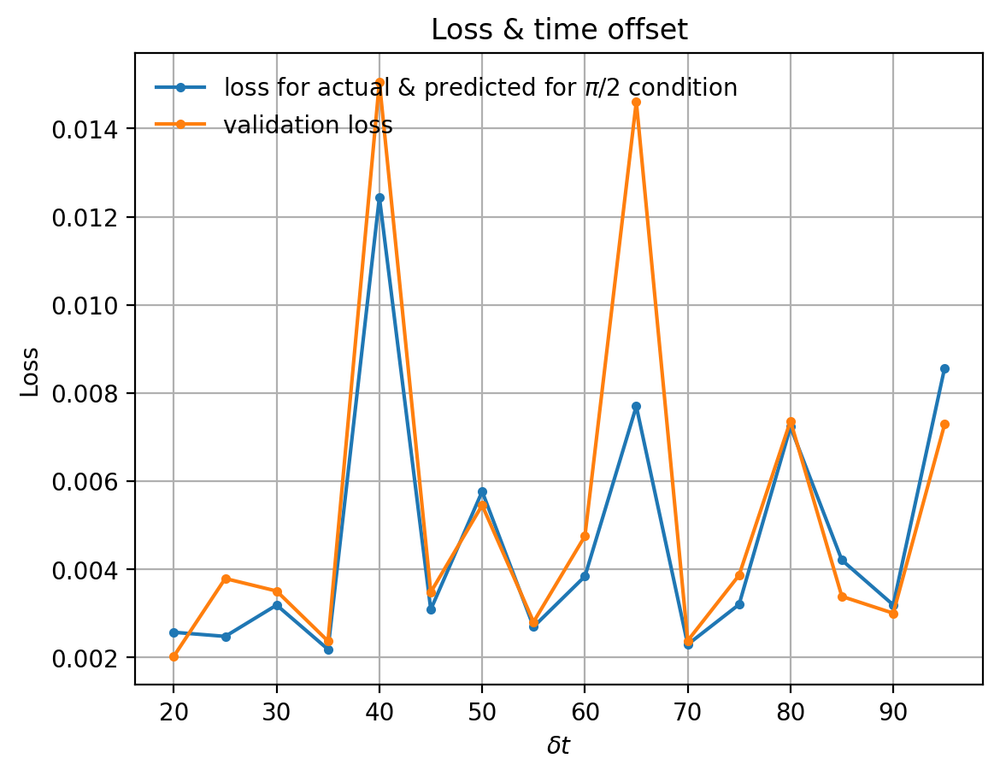

In [275]:
# Plotting the deviation between predicted and actual position for model trained on pi/2 initial condition

fig, ax = plt.subplots()

ax.plot(offsets, losses, label='loss for actual & predicted for $\pi$/2 condition', marker='.')
ax.plot(offsets, val_losses, label='validation loss', marker='.')
ax.set_title('Loss & time offset')
ax.set_xlabel(r'$\delta t$')
ax.set_ylabel('Loss')
ax.grid(True)
ax.legend(loc='upper left')

As we can see above the difference loss function as we vary the time step is different from before, as the model only has mass 2, it has less information about the coupled relationship between the two but it also has less to calculate as we just care about one mass, as before we still have a clear minimum, here it's at20 and followed closely 35 & 70 and a maximum at 40, this is very interesting, there seems to be a weak positive correlation over time but the loss plot seems to be almost periodic, this might be saying something about how thre mass 1 acts on mass 2 like a periodic force acted out of phase, so in certain timesteps, the 'randomness' / spikes and so does the loss as the LMST doesn't know what's causing the change (hence why I say 'randomness'
We could imrpove accuracy by adding more layers to the network or increasing the number of epochs but I think the returns on doing this is not worth it because if the immense time it'll take to compute, at that point it's better to move to another problem.


Now we do the whole thing again but this time train the model using initial parameters of pi/2 which will make the path more complex so we train the model on that but ofcourse this time we are only taking the positions of mass 2

(4, 501)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)


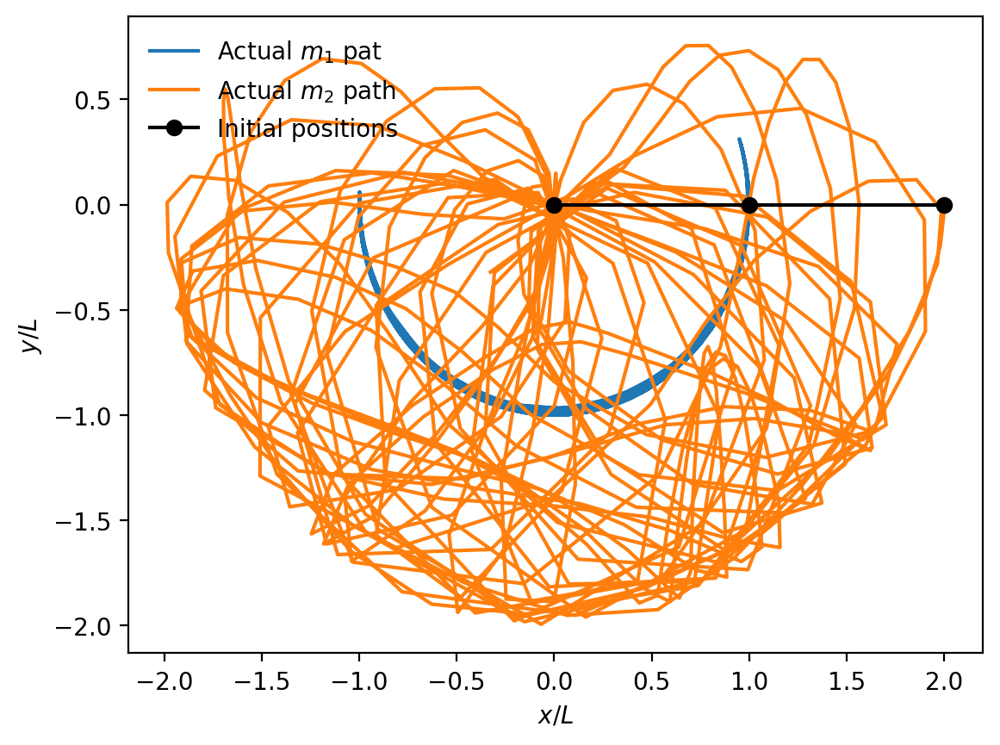

In [274]:
# Set up the initial conditions. Here we have lengths and masses
L1, L2 = 1., 1.
m1, m2 = 3., 1.
g = 9.81     # [m/s^2]. Gravitational acceleration

#Starting angles, using pi/2 this time
z0=[np.pi/2,0,np.pi/2,0]
#z0=[0.1,0,0.1,0]

#Time ranges
tmax, dt = 50, 0.1
t = np.arange(0, tmax+dt, dt)

z_param = [[np.pi/8,0,np.pi/8,0], [2*np.pi/8,0,2*np.pi/8,0], [3*np.pi/8,0,3*np.pi/8,0], [4*np.pi/8,0,4*np.pi/8,0], [5*np.pi/8,0,5*np.pi/8,0], [6*np.pi/8,0,6*np.pi/8,0], [7*np.pi/8,0,7*np.pi/8,0], [8*np.pi/8,0,8*np.pi/8,0]]

#initial value problem
ret = solve_ivp(rhs, (0,tmax), z0, t_eval=t, args=(L1, L2, m1, m2, g))
z=ret.y
print(np.shape(z))

# Extract result
theta1, w1, theta2, w2 = z[0], z[1], z[2], z[3]
x1, y1, x2, y2, vx1, vy1, vx2, vy2 = to_cartesian(theta1, w1, theta2, w2, L1, L2)


fig,ax=plt.subplots()
ax.plot(x1, y1, label=r"Actual $m_1$ pat")
ax.plot(x2, y2, label=r"Actual $m_2$ path")
ax.plot([0, x1[0], x2[0]], [0, y1[0], y2[0]], "-o", label="Initial positions", c='k')
plt.xlabel(r"$x/L$")
plt.ylabel(r"$y/L$")
ax.legend()

In [278]:
# Set the offset and windowsize

windowSize = 50
offset = 20

# create the test and tran data
X_train, X_test, Y_train, Y_test = train_model_127(x2, y2, windowsize, offset)

# print the shapes
print(f'{X_train.shape, Y_train.shape, X_test.shape, Y_test.shape} shapes are as expected')

# Increased the number of epochs, could've increased the neural network size too but want to see a 'direct comparison' in accuracy before so I'll leave it the same
train_model_121(LSTM, X_train, Y_train, X_test, Y_test, epochs=75)

((324, 50, 2), (324, 2), (108, 50, 2), (108, 2)) shapes are as expected
Epoch 1/75
11/11 - 3s - loss: 0.8725 - accuracy: 0.6914 - val_loss: 0.6709 - val_accuracy: 0.6944 - 3s/epoch - 232ms/step
Epoch 2/75
11/11 - 2s - loss: 0.6420 - accuracy: 0.7037 - val_loss: 0.6408 - val_accuracy: 0.6944 - 2s/epoch - 222ms/step
Epoch 3/75
11/11 - 2s - loss: 0.6214 - accuracy: 0.7037 - val_loss: 0.5848 - val_accuracy: 0.6944 - 2s/epoch - 179ms/step
Epoch 4/75
11/11 - 1s - loss: 0.5764 - accuracy: 0.6975 - val_loss: 0.5380 - val_accuracy: 0.6574 - 1s/epoch - 96ms/step
Epoch 5/75
11/11 - 1s - loss: 0.5536 - accuracy: 0.7037 - val_loss: 0.5046 - val_accuracy: 0.6944 - 1s/epoch - 95ms/step
Epoch 6/75
11/11 - 1s - loss: 0.5182 - accuracy: 0.7006 - val_loss: 0.4880 - val_accuracy: 0.7315 - 1s/epoch - 98ms/step
Epoch 7/75
11/11 - 1s - loss: 0.5018 - accuracy: 0.7222 - val_loss: 0.4912 - val_accuracy: 0.7130 - 1s/epoch - 99ms/step
Epoch 8/75
11/11 - 1s - loss: 0.4607 - accuracy: 0.7253 - val_loss: 0.4395 - v

(0.03775110840797424, 0.1285824179649353)

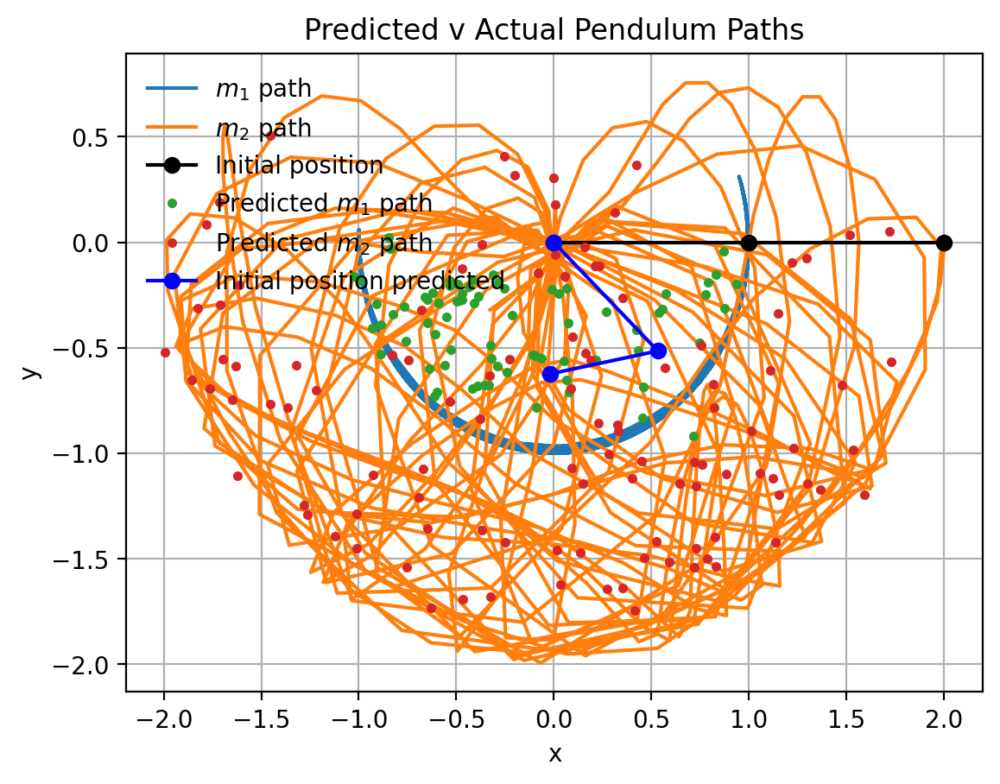

In [279]:
# Accuracy of 97% acheived, val loss of 0.13, and los of 0.04, not bad considering we did not change the network, but again we have less information to care about

motion_LSTM = LSTM.predict_on_batch(X_test)


x2_predicted = motion_LSTM[:,0]

y2_predicted = motion_LSTM[:,1]

# Plotting the paths

fig, ax = plt.subplots()




# true data
ax.plot(x1, y1, label=r"$m_1$ path")
ax.plot(x2, y2, label=r"$m_2$ path")
ax.plot([0, x1[0], x2[0]], [0, y1[0], y2[0]], "-o", label="Initial position", c='k')

# LSTM path
ax.plot(x1_predicted, y1_predicted, label=r"Predicted $m_1$ path", marker='.', linestyle = '')
ax.plot(x2_predicted, y2_predicted, label=r"Predicted $m_2$ path", marker='.', linestyle = '')
ax.plot([0, x1_predicted[0], x2_predicted[0]], [0, y1_predicted[0], y2_predicted[0]], "-o", label="Initial position predicted", c='b')



ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_title('Predicted v Actual Pendulum Paths')
ax.legend(loc='upper left')
ax.grid(True)

Not a bad distributon, again I question it's accepability but It's still follwoing somehwat decently despite these conditions make the path more complex and therfore it should be harder to predict.
finally, testing on 8 different initial theta paramaters

Shape of z array: (4, 501)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of real motion arrays:
x1: (501,)
y1: (501,)
x2: (501,)
y2: (501,)
vx1: (501,)
vy1: (501,)
vx2: (501,)
vy2: (501,)
Shape of z array: (4, 501)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of real motion arrays:
x1: (501,)
y1: (501,)
x2: (501,)
y2: (501,)
vx1: (501,)
vy1: (501,)
vx2: (501,)
vy2: (501,)
Shape of z array: (4, 501)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Shapes of real motion

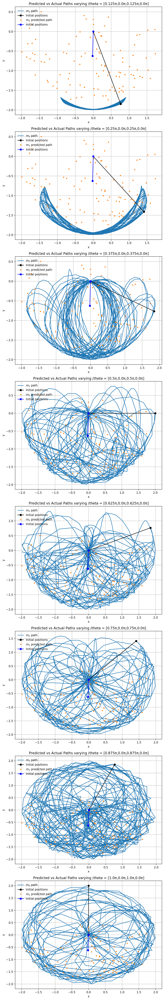

In [280]:
z_param = [[np.pi/8,0,np.pi/8,0], [2*np.pi/8,0,2*np.pi/8,0], [3*np.pi/8,0,3*np.pi/8,0], [4*np.pi/8,0,4*np.pi/8,0], [5*np.pi/8,0,5*np.pi/8,0], [6*np.pi/8,0,6*np.pi/8,0], [7*np.pi/8,0,7*np.pi/8,0], [8*np.pi/8,0,8*np.pi/8,0]]


fig, axes = plt.subplots(len(z_param), 1, figsize=(8, 6 * len(z_param)))

for i, z in enumerate(z_param):
    x1, y1, x2, y2, x2_p, y2_p = predicted_path_227(z)

    # Plotting true data
    axes[i].plot(x2, y2, label=r"$m_2$ path")
    axes[i].plot([0, x2[0]], [0, y2[0]], "-o", label="Initial positions", c='k')

    # Plotting predicted data
    axes[i].plot(x2_predicted, y2_predicted, label=r"$m_2$ predicted path", marker='.', linestyle='')
    axes[i].plot([0, x2_predicted[0]], [0, y2_predicted[0]], "-o", label="Initial positions", c='b')

    axes[i].set_xlabel('x')
    axes[i].set_ylabel('y')
    axes[i].set_title(f"Predicted vs Actual Paths varying $/theta$ = [{np.array(z)[0]/np.pi}π,{np.array(z)[1]/np.pi}π,{np.array(z)[2]/np.pi}π,{np.array(z)[3]/np.pi}π]")
    axes[i].legend(loc='upper left')
    axes[i].grid(True)

plt.tight_layout()
plt.show()

The m2 predictions of positions look like they're almost random, again like throwing darts at a darkboard where there's a duistrubution that averages out to near the middle but still a bit over the place, as the theta values increase for the initial values, they seem to start covering more of the path of mass 2 but again like before, as mass 2 covers a greater area, the 'random' behavior covers more of the area also covered by the pendulumn motion of mass 2 so it appears more accurate when it might not be, that said the average of the distribtutions seem to change and adapt slihglty, as we see for the 3/8pi theta value almost no points are in the dead middle where the mass did not go, so it is learning something, just alot of either under or overfitting, again we probably could have juiced up the network to yeild stronger results but it still is doing somehting and we can se eit's not as good when compared with the model trained on both masses, even though we increaes the number of epochs by a substaintial amount

In [281]:
# Final test - varying offset values

# copying from above, again
L1, L2 = 1., 1.
m1, m2 = 3., 1.
g = 9.81     # [m/s^2]. Gravitational acceleration

#Starting angles
z0=[np.pi/2,0,np.pi/2,0]
#z0=[0.1,0,0.1,0]

#Time ranges
tmax, dt = 50, 0.1
t = np.arange(0, tmax+dt, dt)

# Solve initial value problem
ret = solve_ivp(rhs, (0,tmax), z0, t_eval=t, args=(L1, L2, m1, m2, g))
z=ret.y
print(np.shape(z))

# Extract result
theta1, w1, theta2, w2 = z[0], z[1], z[2], z[3]
x1, y1, x2, y2, vx1, vy1, vx2, vy2 = to_cartesian(theta1, w1, theta2, w2, L1, L2)

LSTM = LSTM_model_2()



# empty arrays for loss
losses = []
val_losses=[]

# increase timestep from 20 -> 100 in steps of 5

offsets = np.arange(20,100,5)


#retraining the LSTM and test as in step 1 for each of the offsets
for offset in tqdm(offsets):
    LSTM = LSTM_model_2()

    # create the test and tran data
    X_train, X_test, Y_train, Y_test = train_model_127(x2, y2, windowsize, offset)

    # 50 epochs this time vs 30 so gonna take years..
    loss, val_loss = train_model_121(LSTM, X_train, Y_train, X_test, Y_test,epochs=50)

    losses.append(loss)
    val_losses.append(val_loss)

(4, 501)
Shapes of x1, y1, x2, y2, vx1, vy1, vx2, vy2 arrays:
(501,) (501,) (501,) (501,) (501,) (501,) (501,) (501,)
Model: "sequential_82"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_231 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_232 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_233 (LSTM)             (None, 100)               60400     
                                                                 
 dense_134 (Dense)           (None, 30)                3030      
                                                                 
 dense_135 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 K

  0%|          | 0/16 [00:00<?, ?it/s]

Model: "sequential_83"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_234 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_235 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_236 (LSTM)             (None, 100)               60400     
                                                                 
 dense_136 (Dense)           (None, 30)                3030      
                                                                 
 dense_137 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
11

  6%|▋         | 1/16 [01:19<19:54, 79.66s/it]

Model: "sequential_84"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_237 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_238 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_239 (LSTM)             (None, 100)               60400     
                                                                 
 dense_138 (Dense)           (None, 30)                3030      
                                                                 
 dense_139 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
10

 12%|█▎        | 2/16 [02:47<19:43, 84.53s/it]

Model: "sequential_85"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_240 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_241 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_242 (LSTM)             (None, 100)               60400     
                                                                 
 dense_140 (Dense)           (None, 30)                3030      
                                                                 
 dense_141 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
10

 19%|█▉        | 3/16 [04:11<18:16, 84.38s/it]

Model: "sequential_86"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_243 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_244 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_245 (LSTM)             (None, 100)               60400     
                                                                 
 dense_142 (Dense)           (None, 30)                3030      
                                                                 
 dense_143 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
10

 25%|██▌       | 4/16 [05:41<17:16, 86.34s/it]

Model: "sequential_87"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_246 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_247 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_248 (LSTM)             (None, 100)               60400     
                                                                 
 dense_144 (Dense)           (None, 30)                3030      
                                                                 
 dense_145 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
10

 31%|███▏      | 5/16 [07:12<16:08, 88.03s/it]

Model: "sequential_88"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_249 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_250 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_251 (LSTM)             (None, 100)               60400     
                                                                 
 dense_146 (Dense)           (None, 30)                3030      
                                                                 
 dense_147 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
10

 38%|███▊      | 6/16 [08:33<14:17, 85.78s/it]

Model: "sequential_89"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_252 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_253 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_254 (LSTM)             (None, 100)               60400     
                                                                 
 dense_148 (Dense)           (None, 30)                3030      
                                                                 
 dense_149 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
10

 44%|████▍     | 7/16 [10:03<13:02, 86.97s/it]

Model: "sequential_90"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_255 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_256 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_257 (LSTM)             (None, 100)               60400     
                                                                 
 dense_150 (Dense)           (None, 30)                3030      
                                                                 
 dense_151 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
10

 50%|█████     | 8/16 [11:31<11:40, 87.53s/it]

Model: "sequential_91"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_258 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_259 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_260 (LSTM)             (None, 100)               60400     
                                                                 
 dense_152 (Dense)           (None, 30)                3030      
                                                                 
 dense_153 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
10

 56%|█████▋    | 9/16 [12:46<09:44, 83.47s/it]

Model: "sequential_92"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_261 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_262 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_263 (LSTM)             (None, 100)               60400     
                                                                 
 dense_154 (Dense)           (None, 30)                3030      
                                                                 
 dense_155 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
10

 62%|██████▎   | 10/16 [14:14<08:29, 84.97s/it]

Model: "sequential_93"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_264 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_265 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_266 (LSTM)             (None, 100)               60400     
                                                                 
 dense_156 (Dense)           (None, 30)                3030      
                                                                 
 dense_157 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
9/

 69%|██████▉   | 11/16 [15:42<07:08, 85.76s/it]

Model: "sequential_94"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_267 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_268 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_269 (LSTM)             (None, 100)               60400     
                                                                 
 dense_158 (Dense)           (None, 30)                3030      
                                                                 
 dense_159 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
9/

 75%|███████▌  | 12/16 [16:50<05:22, 80.55s/it]

Model: "sequential_95"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_270 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_271 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_272 (LSTM)             (None, 100)               60400     
                                                                 
 dense_160 (Dense)           (None, 30)                3030      
                                                                 
 dense_161 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
9/

 81%|████████▏ | 13/16 [17:54<03:45, 75.31s/it]

Model: "sequential_96"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_273 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_274 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_275 (LSTM)             (None, 100)               60400     
                                                                 
 dense_162 (Dense)           (None, 30)                3030      
                                                                 
 dense_163 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
9/

 88%|████████▊ | 14/16 [18:56<02:22, 71.43s/it]

Model: "sequential_97"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_276 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_277 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_278 (LSTM)             (None, 100)               60400     
                                                                 
 dense_164 (Dense)           (None, 30)                3030      
                                                                 
 dense_165 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
9/

 94%|█████████▍| 15/16 [20:24<01:16, 76.51s/it]

Model: "sequential_98"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_279 (LSTM)             (None, None, 100)         41200     
                                                                 
 lstm_280 (LSTM)             (None, None, 50)          30200     
                                                                 
 lstm_281 (LSTM)             (None, 100)               60400     
                                                                 
 dense_166 (Dense)           (None, 30)                3030      
                                                                 
 dense_167 (Dense)           (None, 2)                 62        
                                                                 
Total params: 134892 (526.92 KB)
Trainable params: 134892 (526.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
9/

100%|██████████| 16/16 [21:52<00:00, 82.02s/it]


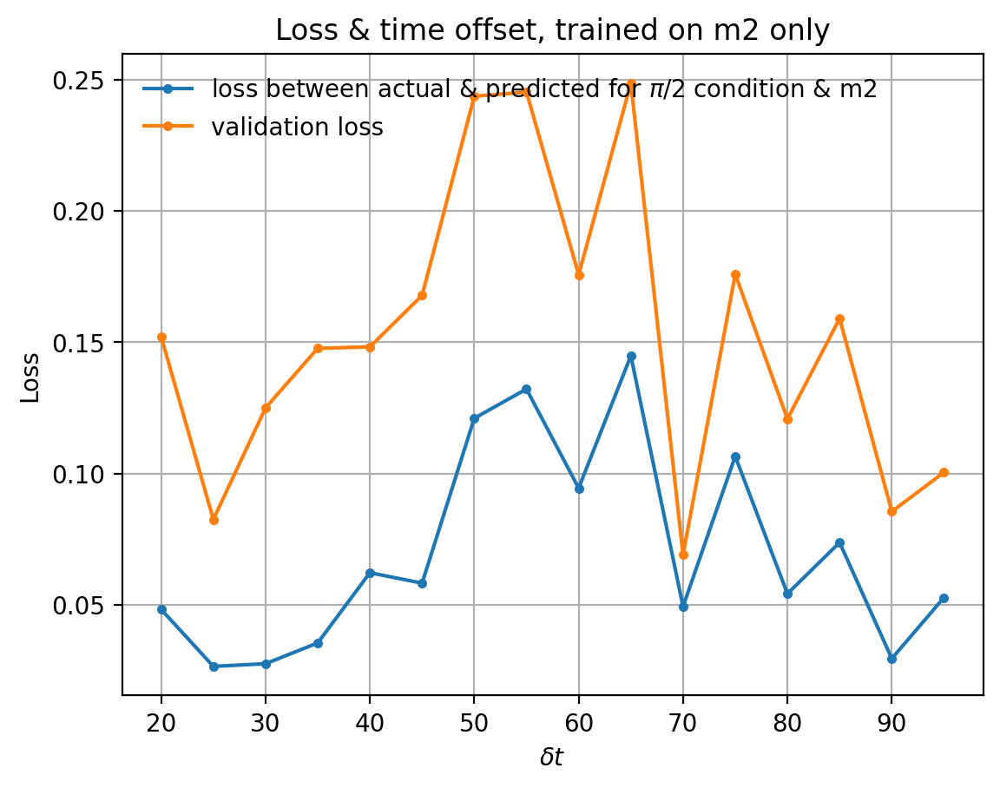

In [283]:
# Plotting the deviation between predicted and actual position for model trained on pi/2 initial condition

fig, ax = plt.subplots()

ax.plot(offsets, losses, label='loss between actual & predicted for $\pi$/2 condition & m2', marker='.')
ax.plot(offsets, val_losses, label='validation loss', marker='.')
ax.set_title('Loss & time offset, trained on m2 only')
ax.set_xlabel(r'$\delta t$')
ax.set_ylabel('Loss')
ax.grid(True)
ax.legend(loc='upper left')


### Conclusion

As we can see from above, the losses are far far greater this time around compared to when we tested this initial condition using both the positions for mass 1 and mass 2, again as they are coupled systems, one effects the other and even though the model may not understand the physics / laws of motion, it is still able to learn how they both change together and thus removing mass 1 made it a lot harder to predict

The loss ranges from about 0.02 at 30 to a huge 0.25 btween 50 & 70, surprisingly theres not a strong positive correlation and once again might have something to do with the path being so crazy and the preiod like force applied on m2 by m1 means that having steps out of step with the force can make it more confusing for the model to predict any next steps, maybe if we extened it to 1000 instead of 100, we'd see a massive increase in loss.

Ofcourse this does not work the other way around, just predicting mass 1 using mass 1 data would yeild a far more accurate prediction and hence a smaller loss, this is because mass 1 has a smaller length for the pendulum and on top of that it is in a way effected less, at least in the area it covers, there's a smaller distribution if you will so the model could probably get more points in the somewhat correct places easier, we could of also boosted the neural network size by introducing more layers, maybe even experiementing with the optimizers, and the window siz (increasing should lead to more accuracy), using the best offset using the data from the loss plot, increased the number of epochs then the predicted plot would be far closer to the actual one but it would require immense computing power and even then it'll probably take a while, in this notebook alone I think there is a total run time of 2+ hours using my laptop

Anyway, that concludes our investigation of LSTMS, we havesneen how they work, we've tested them on different intial paramaters, we've also trained them on different initial conditions, seen how they react to a increasingly complicated system and seen their limitations, at the end of the day they can't figure out more than they're told but are great at what they do which is predicting patterns within a given window so they have the advantage over other methods by not carrying 'baggage' from too far in the past (only whatever the given window size is)